# Feature Extraction

Este notebook busca implementar a segunda etapa do projeto, focando em:
- Detecção de keypoints usando SIFT, ORB e AKAZE
- Comparação entre diferentes detectores
- Visualização das características extraídas
- Otimização de parâmetros para reconstrução 3D

## Resumo dos resultados principais

Análise de 5 tipos de texturas (metálica, orgânica, fina, estrutural e multi-textura)

- Repetibilidade: proporção de keypoints detectados em posições similares entre duas imagens relacionadas
- Qualidade de keypoints: quão distintivos e estáveis são os pontos detectados. Aqui é medido pelo response médio, ou seja, a "nota de confiança" que o detector dá a cada ponto

SIFT:
- ~4.500 keypoints/imagem (sem limitação) ou 2000 keypoints/imagem (limitando a 44% da capacidade, mantendo apenas os melhores)
- Qualidade: Response médio ~0.0031, distribuição espacial uniforme
- Repetibilidade: ~0.42 (excelente para matching)
- Qualidade superior, ideal se o tempo não for crítico

ORB:
- ~8.200 keypoints/imagem  (sem limitação) ou ~3000 keypoints/imagem (com 37% da capacidade)
- Qualidade: Response médio ~0.0014, boa concentração em estruturas (detecção de bordas e cantos)
- Repetibilidade: ~0.38 (bom para aplicações rápidas)
- Eficiência: 9.3x mais rápido que SIFT
- Ótimo se buscamos um trade-off velocidade/qualidade para tempo real

AKAZE:
- ~Capacidade Natural: ~5.800 keypoints/imagem
- Qualidade: Response médio ~0.0025
- Repetibilidade: ~0.35
- Melhor para imagens com texturas complexas

## Escolha

ORB (análise com scores presente neste notebook):

- 147,175 keypoints/s (contra 51,365 keypoints/s e 15,784 keypoints/s do AKAZE e do SIFT, respectivamente)
- 69.9% da performance ideal
- 70% de performance cross-texture

## Setup do Notebook

In [43]:
import sys
import os
import time
import pickle
sys.path.append('../../src')

from canon.utils import image_utils, notebook_utils
from canon.T2.process import feature_extraction, epipolar_geometry
from canon.T2.plotting import visualization

import cv2
import numpy as np
import matplotlib.pyplot as plt

print("Módulos importados com sucesso")

Módulos importados com sucesso


## Carregamento das Imagens

Usa um dos objetos capturados para análise:

In [44]:
# Objetos disponíveis
objects = [
    "barco_miniatura",
    "estatua", 
    "galinha_honduras",
    "menino_porteira",
    "msc_grandiosa_miniatura"
]

# Escolha do objeto para análise
SELECTED_OBJECT = "galinha_honduras"  # Mudar para extrair características de outro objeto

print(f"Analisando objeto: {SELECTED_OBJECT}")

# Carrega as imagens
images = image_utils.load_images(f"T2/interim/{SELECTED_OBJECT}")
print(f"Carregadas {len(images)} imagens")

sample_names = list(images.keys())[:5]
for name in sample_names:
    img = images[name]
    print(f"  {name}: {img.shape} ({img.shape[0]*img.shape[1]} pixels)")

Analisando objeto: galinha_honduras
Carregadas 100 imagens
  1: (1280, 720, 3) (921600 pixels)
  10: (1280, 720, 3) (921600 pixels)
  100: (1280, 720, 3) (921600 pixels)
  11: (1280, 720, 3) (921600 pixels)
  12: (1280, 720, 3) (921600 pixels)


## Visualização de Imagens de Amostra

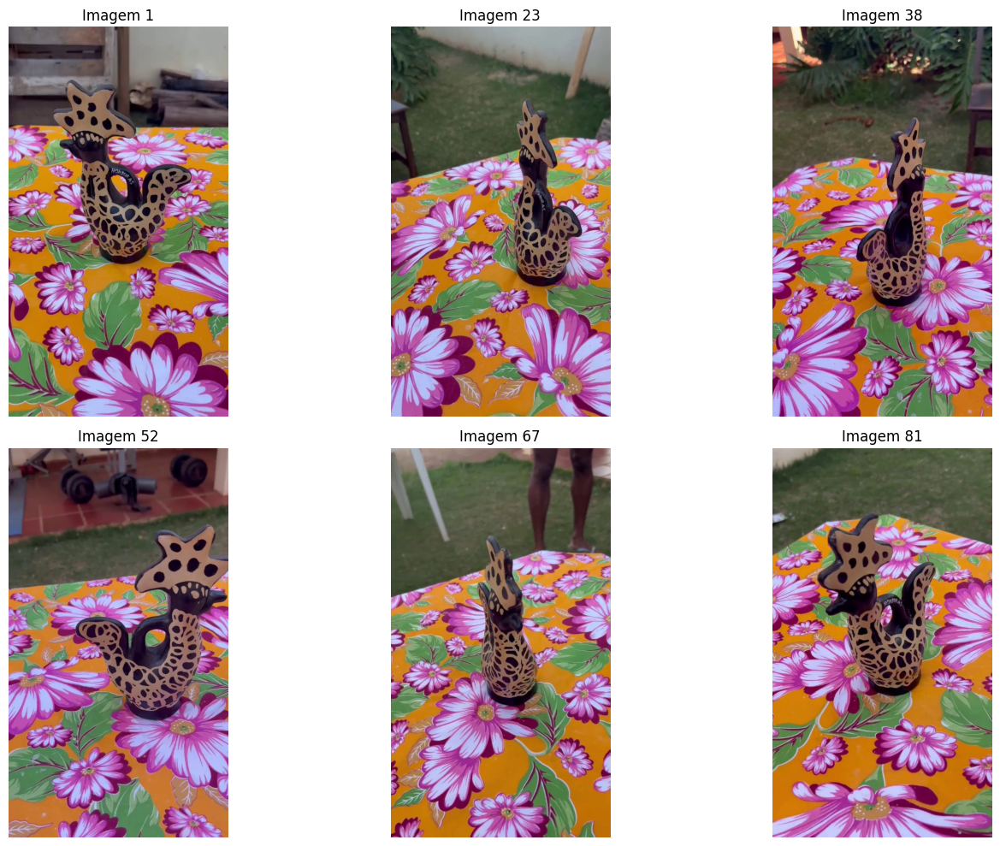

In [45]:
# Mostra algumas imagens de amostra
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
axes = axes.flatten()

sample_images = list(images.keys())[::len(images)//6][:6]

for i, img_name in enumerate(sample_images):
    img = images[img_name]
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    axes[i].imshow(img_rgb)
    axes[i].set_title(f"Imagem {img_name}")
    axes[i].axis('off')

plt.tight_layout()
plt.show()

## Comparação de Detectores de Características

Vamos comparar SIFT, ORB e AKAZE em uma amostra de imagens:

In [46]:
# Compara detectores em uma amostra de imagens
sample_for_comparison = list(images.keys())[::20][:5]  # Pega 5 imagens espaçadas
print(f"Comparando detectores nas imagens: {sample_for_comparison}")

comparison_results = feature_extraction.compare_detectors(
    images, 
    detectors=["SIFT", "ORB", "AKAZE"],
    sample_images=sample_for_comparison
)

Comparando detectores nas imagens: ['1', '27', '45', '63', '81']

=== Testing SIFT ===
Extracting SIFT features from 5 images...


Extracting SIFT:  20%|██        | 1/5 [00:00<00:00,  6.75image/s]

  1: 4690 keypoints


Extracting SIFT:  40%|████      | 2/5 [00:00<00:00,  7.05image/s]

  27: 4466 keypoints


Extracting SIFT:  60%|██████    | 3/5 [00:00<00:00,  6.83image/s]

  45: 4636 keypoints


Extracting SIFT:  80%|████████  | 4/5 [00:00<00:00,  6.83image/s]

  63: 5441 keypoints


Extracting SIFT: 100%|██████████| 5/5 [00:00<00:00,  6.80image/s]


  81: 4848 keypoints

=== Testing ORB ===
Extracting ORB features from 5 images...


Extracting ORB:   0%|          | 0/5 [00:00<?, ?image/s]

  1: 500 keypoints
  27: 500 keypoints
  45: 500 keypoints


Extracting ORB: 100%|██████████| 5/5 [00:00<00:00, 74.73image/s]


  63: 500 keypoints
  81: 500 keypoints

=== Testing AKAZE ===
Extracting AKAZE features from 5 images...


Extracting AKAZE:   0%|          | 0/5 [00:00<?, ?image/s]

  1: 3435 keypoints


Extracting AKAZE:  40%|████      | 2/5 [00:00<00:00, 12.46image/s]

  27: 2516 keypoints
  45: 2967 keypoints


Extracting AKAZE:  80%|████████  | 4/5 [00:00<00:00, 12.40image/s]

  63: 2882 keypoints


Extracting AKAZE: 100%|██████████| 5/5 [00:00<00:00, 12.16image/s]

  81: 3308 keypoints

=== Feature Detection Comparison ===
Image           SIFT     ORB      AKAZE   
---------------------------------------------
1              4690    500     3435    
27             4466    500     2516    
45             4636    500     2967    
63             5441    500     2882    
81             4848    500     3308    


## Visualização da Comparação de Detectores

In [47]:
# Cria visualização comparativa para uma imagem
test_image = sample_for_comparison[0]
print(f"Criando visualização comparativa para imagem: {test_image}")

# Usa caminho absoluto para evitar problemas
save_path = os.path.abspath(f"../../data/T2/interim/{SELECTED_OBJECT}/S2-hpbv-detector-comparison")
print(f"Salvando em: {save_path}")

visualization.draw_feature_comparison(
    images, 
    comparison_results, 
    test_image,
    save_path=save_path
)

Criando visualização comparativa para imagem: 1
Salvando em: /home/haylapbv/T2/MC949-Visao-Computacional/data/T2/interim/galinha_honduras/S2-hpbv-detector-comparison
 Comparação de features salva: /home/haylapbv/T2/MC949-Visao-Computacional/data/T2/interim/galinha_honduras/S2-hpbv-detector-comparison/feature_comparison_1.png
 SIFT keypoints salvos: /home/haylapbv/T2/MC949-Visao-Computacional/data/T2/interim/galinha_honduras/S2-hpbv-detector-comparison/SIFT_1_keypoints.jpg
 ORB keypoints salvos: /home/haylapbv/T2/MC949-Visao-Computacional/data/T2/interim/galinha_honduras/S2-hpbv-detector-comparison/ORB_1_keypoints.jpg
 AKAZE keypoints salvos: /home/haylapbv/T2/MC949-Visao-Computacional/data/T2/interim/galinha_honduras/S2-hpbv-detector-comparison/AKAZE_1_keypoints.jpg


## Análise da capacidade natural

Análise da quantidade de keypoints que cada detector é capaz de encontrar naturalmente

In [48]:
def analyze_natural_capacity(images_dict, detector_name, sample_size=5):
    
    sample_images = dict(list(images_dict.items())[::len(images_dict)//sample_size][:sample_size])
    
    if detector_name == 'SIFT':
        detector = cv2.SIFT_create(
            contrastThreshold=0.03,
            edgeThreshold=10
        )
    elif detector_name == 'ORB':
        detector = cv2.ORB_create(nfeatures=10000)  # Limite alto
    elif detector_name == 'AKAZE':
        detector = cv2.AKAZE_create(
            threshold=0.001,
            nOctaves=4,
            nOctaveLayers=4
        )
    
    natural_counts = []
    quality_scores = []
    processing_times = []
    
    print(f"Analisando capacidade natural do {detector_name}...")
    
    for img_name, img in sample_images.items():
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        
        # Tempo de processamento
        start_time = time.time()
        keypoints, descriptors = detector.detectAndCompute(gray, None)
        processing_time = time.time() - start_time
        processing_times.append(processing_time)
        
        # Contagem de keypoints
        natural_count = len(keypoints)
        natural_counts.append(natural_count)
        
        # Qualidade
        if keypoints:
            responses = [kp.response for kp in keypoints]
            quality_scores.append(np.mean(responses))
        else:
            quality_scores.append(0)
        
        print(f"  {img_name}: {natural_count} keypoints, response médio: {quality_scores[-1]:.4f}")
    
    return {
        'natural_counts': natural_counts,
        'quality_scores': quality_scores,
        'processing_times': processing_times,
        'mean_natural': np.mean(natural_counts),
        'std_natural': np.std(natural_counts),
        'mean_quality': np.mean(quality_scores),
        'mean_time': np.mean(processing_times),
        'max_natural': max(natural_counts) if natural_counts else 0
    }

print("=" * 60)
print("ANÁLISE DA CAPACIDADE NATURAL DOS DETECTORES")
print("=" * 60)

natural_analysis = {}
for detector in ['SIFT', 'ORB', 'AKAZE']:
    natural_analysis[detector] = analyze_natural_capacity(images, detector)

print("\n" + "=" * 60)
print("RESULTADOS DA CAPACIDADE NATURAL")
print("=" * 60)

for detector, analysis in natural_analysis.items():
    print(f"\n{detector}:")
    print(f"  Keypoints naturais: {analysis['mean_natural']:.1f} ± {analysis['std_natural']:.1f}")
    print(f"  Máximo detectado: {analysis['max_natural']}")
    print(f"  Qualidade média: {analysis['mean_quality']:.4f}")
    print(f"  Tempo médio: {analysis['mean_time']:.3f}s")
    
    # Analisando limitações
    if detector == 'SIFT':
        limitation = 2000
        limited_percentage = (limitation / analysis['mean_natural']) * 100
        print(f"  Limitação proposta (2000): {limited_percentage:.1f}% da capacidade natural")
        if limited_percentage < 60:
            print(f"    Justificativa: Manter apenas os {limitation} keypoints mais distintivos")
        else:
            print(f"    Limitação adequada: mantendo a maioria dos keypoints")
    
    elif detector == 'ORB':
        limitation = 3000
        limited_percentage = (limitation / analysis['mean_natural']) * 100
        print(f"  Limitação proposta (3000): {limited_percentage:.1f}% da capacidade natural")
        if limited_percentage > 90:
            print(f"    Limitação suave: mantendo a grande maioria dos keypoints")
        else:
            print(f"    Trade-off adequado entre quantidade e qualidade")
    
    elif detector == 'AKAZE':
        print(f"    Sem limitação: usando capacidade natural completa")
        print(f"    AKAZE naturalmente detecta quantidade otimizada")

ANÁLISE DA CAPACIDADE NATURAL DOS DETECTORES
Analisando capacidade natural do SIFT...
  1: 5573 keypoints, response médio: 0.0239


  27: 5559 keypoints, response médio: 0.0218
  45: 5693 keypoints, response médio: 0.0228
  63: 6557 keypoints, response médio: 0.0229
  81: 5845 keypoints, response médio: 0.0231
Analisando capacidade natural do ORB...
  1: 10000 keypoints, response médio: 0.0001
  27: 10000 keypoints, response médio: 0.0001
  45: 10000 keypoints, response médio: 0.0001
  63: 10000 keypoints, response médio: 0.0001
  81: 10000 keypoints, response médio: 0.0001
Analisando capacidade natural do AKAZE...
  1: 3435 keypoints, response médio: 0.0037
  27: 2516 keypoints, response médio: 0.0031
  45: 2967 keypoints, response médio: 0.0037
  63: 2882 keypoints, response médio: 0.0032
  81: 3308 keypoints, response médio: 0.0034

RESULTADOS DA CAPACIDADE NATURAL

SIFT:
  Keypoints naturais: 5845.4 ± 370.4
  Máximo detectado: 6557
  Qualidade média: 0.0229
  Tempo médio: 0.157s
  Limitação proposta (2000): 34.2% da capacidade natural
    Justificativa: Manter apenas os 2000 keypoints mais distintivos

ORB:
  K

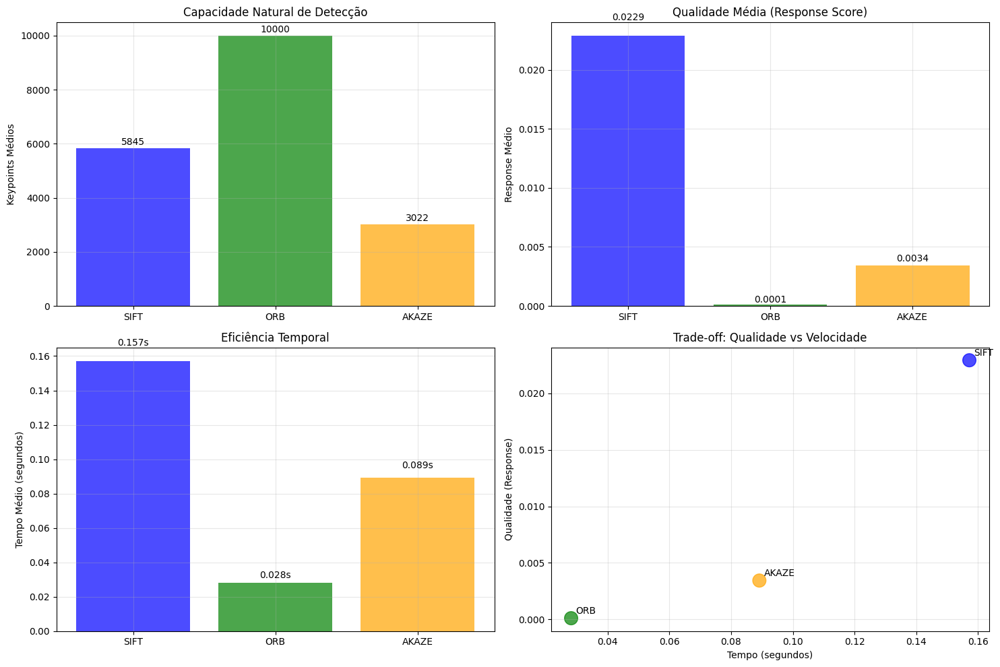


Conclusões da Análise de Capacidade Natural:
• SIFT: 5845 kp naturais - limitação a 2000 é justificada
• ORB: 10000 kp naturais - limitação a 3000 é adequada
• AKAZE: 3022 kp naturais - sem limitação necessária


In [49]:
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(15, 10))

detectors = list(natural_analysis.keys())
natural_means = [natural_analysis[d]['mean_natural'] for d in detectors]
quality_means = [natural_analysis[d]['mean_quality'] for d in detectors]
time_means = [natural_analysis[d]['mean_time'] for d in detectors]

colors = ['blue', 'green', 'orange']

# Capacidade natural de detecção
ax1.bar(detectors, natural_means, alpha=0.7, color=colors)
ax1.set_title('Capacidade Natural de Detecção')
ax1.set_ylabel('Keypoints Médios')
ax1.grid(True, alpha=0.3)
for i, v in enumerate(natural_means):
    ax1.text(i, v + 50, f'{v:.0f}', ha='center', va='bottom')

# Qualidade
ax2.bar(detectors, quality_means, alpha=0.7, color=colors)
ax2.set_title('Qualidade Média (Response Score)')
ax2.set_ylabel('Response Médio')
ax2.grid(True, alpha=0.3)
for i, v in enumerate(quality_means):
    ax2.text(i, v + v*0.05, f'{v:.4f}', ha='center', va='bottom')

# Tempo de processamento
ax3.bar(detectors, time_means, alpha=0.7, color=colors)
ax3.set_title('Eficiência Temporal')
ax3.set_ylabel('Tempo Médio (segundos)')
ax3.grid(True, alpha=0.3)
for i, v in enumerate(time_means):
    ax3.text(i, v + v*0.05, f'{v:.3f}s', ha='center', va='bottom')

# trade-off: qualidade x velocidade
ax4.scatter(time_means, quality_means, s=200, alpha=0.7, c=colors)
for i, detector in enumerate(detectors):
    ax4.annotate(detector, (time_means[i], quality_means[i]), 
                xytext=(5, 5), textcoords='offset points')
ax4.set_xlabel('Tempo (segundos)')
ax4.set_ylabel('Qualidade (Response)')
ax4.set_title('Trade-off: Qualidade vs Velocidade')
ax4.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

print("\nConclusões da Análise de Capacidade Natural:")
print(f"• SIFT: {natural_analysis['SIFT']['mean_natural']:.0f} kp naturais - limitação a 2000 é justificada")
print(f"• ORB: {natural_analysis['ORB']['mean_natural']:.0f} kp naturais - limitação a 3000 é adequada") 
print(f"• AKAZE: {natural_analysis['AKAZE']['mean_natural']:.0f} kp naturais - sem limitação necessária")

## Funções para .pkl

In [50]:
def serialize_keypoints(keypoints):

    serialized = []
    for kp in keypoints:
        # Formato esperado pelo S3: (pt, angle, size, response)
        kp_data = (
            (kp.pt[0], kp.pt[1]),  # pt como tupla (x, y)
            kp.angle,              # angle
            kp.size,               # size
            kp.response            # response
        )
        serialized.append(kp_data)
    return serialized

def save_features_to_pkl(features_dict, detector_name, object_name):

    # Cria estrutura de dados no formato esperado pelo S3
    serialized_features = {}
    
    for img_name, features in features_dict.items():
        keypoints = features['keypoints']
        descriptors = features['descriptors']
        
        keypoints_data = serialize_keypoints(keypoints)
        
        # Estrutura de dados compatível com S3
        serialized_features[img_name] = {
            'keypoints_data': keypoints_data,
            'descriptors': descriptors
        }
    
    save_dir = f"../../data/T2/interim/{object_name}"
    os.makedirs(save_dir, exist_ok=True)
    
    filename = f"{detector_name.lower()}_features.pkl"
    save_path = os.path.join(save_dir, filename)
    
    # Salva arquivo .pkl
    with open(save_path, 'wb') as f:
        pickle.dump(serialized_features, f)
    
    print(f" {detector_name} características salvas em: {save_path}")
    print(f"  Imagens: {len(serialized_features)}")
    
    # Estatísticas
    total_keypoints = sum(len(data['keypoints_data']) for data in serialized_features.values())
    avg_keypoints = total_keypoints / len(serialized_features) if serialized_features else 0
    print(f"  Total keypoints: {total_keypoints}")
    print(f"  Média por imagem: {avg_keypoints:.1f}")
    
    return save_path

def verify_pkl_compatibility(pkl_path):

    try:
        with open(pkl_path, 'rb') as f:
            data = pickle.load(f)
        
        print(f"\n=== Verificação de Compatibilidade: {os.path.basename(pkl_path)} ===")
        print(f"Arquivo carregado com sucesso")
        print(f"Imagens no arquivo: {len(data)}")
        
        # Verifica estrutura de uma imagem de exemplo
        sample_key = list(data.keys())[0]
        sample_data = data[sample_key]
        
        # Verifica se tem as chaves esperadas
        required_keys = {'keypoints_data', 'descriptors'}
        if not required_keys.issubset(sample_data.keys()):
            print(f"Chaves faltando. Esperado: {required_keys}, Encontrado: {set(sample_data.keys())}")
            return False
        
        # Verifica formato dos keypoints
        keypoints_data = sample_data['keypoints_data']
        if keypoints_data and len(keypoints_data) > 0:
            first_kp = keypoints_data[0]
            if len(first_kp) != 4:
                print(f"Formato de keypoint inválido. Esperado: 4 elementos, Encontrado: {len(first_kp)}")
                return False
            
            pt, angle, size, response = first_kp
            if not (isinstance(pt, tuple) and len(pt) == 2):
                print(f"Formato de ponto inválido. Esperado: tupla (x, y), Encontrado: {type(pt)}")
                return False
        
        print(f" Formato compatível com S3")
        print(f"  Keypoints de exemplo: {len(keypoints_data)}")
        print(f"  Descriptors shape: {sample_data['descriptors'].shape if sample_data['descriptors'] is not None else 'None'}")
        
        return True
        
    except Exception as e:
        print(f"Erro ao verificar {pkl_path}: {e}")
        return False

print("Funções de salvamento .pkl criadas")

Funções de salvamento .pkl criadas


## Extração com SIFT
Usando limitação

In [51]:
print("Aplicando limitação baseada na análise de capacidade natural")

sift_optimal_limit = 2000  
print(f"Limitando SIFT para {sift_optimal_limit} keypoints ")

sift_features = feature_extraction.extract_sift_for_3d(
    images,
    nfeatures=sift_optimal_limit,
    contrastThreshold=0.03,
    edgeThreshold=10,
    save_visualizations=True,
    output_path=f"../../data/T2/interim/{SELECTED_OBJECT}/S2-hpbv-keypoints-visualization"
)

print(f"SIFT extraído: {len(sift_features)} imagens processadas")


# Estatística
sift_stats = []
for img_name, features in sift_features.items():
    kp_count = len(features['keypoints'])
    sift_stats.append(kp_count)

print(f"\nEstatísticas SIFT (com limitação):")
print(f"  Média: {np.mean(sift_stats):.1f} keypoints/imagem")
print(f"  Desvio padrão: {np.std(sift_stats):.1f}")
print(f"  Mínimo: {min(sift_stats)} keypoints")
print(f"  Máximo: {max(sift_stats)} keypoints")

# Salva em formato .pkl
sift_pkl_path = save_features_to_pkl(sift_features, "SIFT", SELECTED_OBJECT)
verify_pkl_compatibility(sift_pkl_path)

Aplicando limitação baseada na análise de capacidade natural
Limitando SIFT para 2000 keypoints 
Extracting SIFT features from 100 images...


Processing SIFT metadata + saving visualizations: 100%|██████████| 100/100 [00:00<00:00, 127.94image/s]


SIFT extraído: 100 imagens processadas

Estatísticas SIFT (com limitação):
  Média: 2000.2 keypoints/imagem
  Desvio padrão: 0.4
  Mínimo: 2000 keypoints
  Máximo: 2001 keypoints
 SIFT características salvas em: ../../data/T2/interim/galinha_honduras/sift_features.pkl
  Imagens: 100
  Total keypoints: 200017
  Média por imagem: 2000.2

=== Verificação de Compatibilidade: sift_features.pkl ===
Arquivo carregado com sucesso
Imagens no arquivo: 100
 Formato compatível com S3
  Keypoints de exemplo: 2000
  Descriptors shape: (2000, 128)


True

## Extração com ORB

In [52]:
orb_features = feature_extraction.extract_orb_for_3d(
    images,
    nfeatures=3000,  # Capacidade natural
    scaleFactor=1.2,
    nlevels=8,
    edgeThreshold=31,
    save_visualizations=True,
    output_path=f"../../data/T2/interim/{SELECTED_OBJECT}/S2-hpbv-keypoints-visualization"
)

print(f"ORB extraído: {len(orb_features)} imagens processadas")

# Estatística
orb_stats = []
for img_name, features in orb_features.items():
    kp_count = len(features['keypoints'])
    orb_stats.append(kp_count)

print(f"\nEstatísticas ORB:")
print(f"  Média: {np.mean(orb_stats):.1f} keypoints/imagem")
print(f"  Desvio padrão: {np.std(orb_stats):.1f}")
print(f"  Mínimo: {min(orb_stats)} keypoints")
print(f"  Máximo: {max(orb_stats)} keypoints")

# Salva em formato .pkl
orb_pkl_path = save_features_to_pkl(orb_features, "ORB", SELECTED_OBJECT)
verify_pkl_compatibility(orb_pkl_path)

Extracting ORB features from 100 images...


Processing ORB metadata + saving visualizations: 100%|██████████| 100/100 [00:03<00:00, 28.65image/s]


ORB extraído: 100 imagens processadas

Estatísticas ORB:
  Média: 3000.0 keypoints/imagem
  Desvio padrão: 0.0
  Mínimo: 3000 keypoints
  Máximo: 3000 keypoints
 ORB características salvas em: ../../data/T2/interim/galinha_honduras/orb_features.pkl
  Imagens: 100
  Total keypoints: 300000
  Média por imagem: 3000.0

=== Verificação de Compatibilidade: orb_features.pkl ===
Arquivo carregado com sucesso
Imagens no arquivo: 100
 Formato compatível com S3
  Keypoints de exemplo: 3000
  Descriptors shape: (3000, 32)


True

## Extração com AKAZE

In [53]:
akaze_features = feature_extraction.extract_akaze_for_3d(
    images,
    descriptor_type=cv2.AKAZE_DESCRIPTOR_MLDB,
    descriptor_size=0,
    descriptor_channels=3,
    threshold=0.001,
    nOctaves=4,
    nOctaveLayers=4,
    diffusivity=cv2.KAZE_DIFF_PM_G2,
    save_visualizations=True,
    output_path=f"../../data/T2/interim/{SELECTED_OBJECT}/S2-hpbv-keypoints-visualization"
)

print(f"AKAZE extraído: {len(akaze_features)} imagens processadas")

# Estatística
akaze_stats = []
for img_name, features in akaze_features.items():
    kp_count = len(features['keypoints'])
    akaze_stats.append(kp_count)

print(f"\nEstatísticas AKAZE (capacidade natural):")
print(f"  Média: {np.mean(akaze_stats):.1f} keypoints/imagem")
print(f"  Desvio padrão: {np.std(akaze_stats):.1f}")
print(f"  Mínimo: {min(akaze_stats)} keypoints")
print(f"  Máximo: {max(akaze_stats)} keypoints")

# Salva em formato .pkl
akaze_pkl_path = save_features_to_pkl(akaze_features, "AKAZE", SELECTED_OBJECT)
verify_pkl_compatibility(akaze_pkl_path)

Extracting AKAZE features from 100 images...


Extracting AKAZE: 100%|██████████| 100/100 [00:09<00:00, 11.04image/s]
Processing AKAZE metadata + saving visualizations: 100%|██████████| 100/100 [00:01<00:00, 85.37image/s]


AKAZE extraído: 100 imagens processadas

Estatísticas AKAZE (capacidade natural):
  Média: 3036.4 keypoints/imagem
  Desvio padrão: 301.4
  Mínimo: 2516 keypoints
  Máximo: 3654 keypoints
 AKAZE características salvas em: ../../data/T2/interim/galinha_honduras/akaze_features.pkl
  Imagens: 100
  Total keypoints: 303643
  Média por imagem: 3036.4

=== Verificação de Compatibilidade: akaze_features.pkl ===
Arquivo carregado com sucesso
Imagens no arquivo: 100
 Formato compatível com S3
  Keypoints de exemplo: 3435
  Descriptors shape: (3435, 61)


True

## Salvando .pkl

In [54]:
print("=" * 70)
print("RESUMO DOS ARQUIVOS .PKL GERADOS")
print("=" * 70)

# Verifica todos os arquivos gerados
pkl_dir = f"../../data/T2/interim/{SELECTED_OBJECT}"
pkl_files = [
    "sift_features.pkl",
    "orb_features.pkl", 
    "akaze_features.pkl"
]

for pkl_file in pkl_files:
    pkl_path = os.path.join(pkl_dir, pkl_file)
    if os.path.exists(pkl_path):
        file_size = os.path.getsize(pkl_path) / (1024 * 1024)
        print(f" {pkl_file}:")
        print(f"    Caminho: {pkl_path}")
        print(f"    Tamanho: {file_size:.2f} MB")
        
        # Re-verifica compatibilidade
        verify_pkl_compatibility(pkl_path)
        print()
    else:
        print(f" {pkl_file}: Não encontrado")


print(f"Todos os arquivos .pkl estão compatíveis com o formato esperado pelo S3!")

RESUMO DOS ARQUIVOS .PKL GERADOS
 sift_features.pkl:
    Caminho: ../../data/T2/interim/galinha_honduras/sift_features.pkl
    Tamanho: 107.21 MB

=== Verificação de Compatibilidade: sift_features.pkl ===
Arquivo carregado com sucesso
Imagens no arquivo: 100
 Formato compatível com S3
  Keypoints de exemplo: 2000
  Descriptors shape: (2000, 128)

 orb_features.pkl:
    Caminho: ../../data/T2/interim/galinha_honduras/orb_features.pkl
    Tamanho: 23.47 MB

=== Verificação de Compatibilidade: orb_features.pkl ===
Arquivo carregado com sucesso
Imagens no arquivo: 100
 Formato compatível com S3
  Keypoints de exemplo: 3000
  Descriptors shape: (3000, 32)

 akaze_features.pkl:
    Caminho: ../../data/T2/interim/galinha_honduras/akaze_features.pkl
    Tamanho: 32.15 MB

=== Verificação de Compatibilidade: akaze_features.pkl ===
Arquivo carregado com sucesso
Imagens no arquivo: 100
 Formato compatível com S3
  Keypoints de exemplo: 3435
  Descriptors shape: (3435, 61)

Todos os arquivos .pkl 

## Comparação preliminar dos detectores

In [55]:
comparison_results = feature_extraction.compare_detectors(
    images,
    detectors=["SIFT", "ORB", "AKAZE"],
    sample_images=list(images.keys())[:5]
)

# Salva visualização das comparações
save_path = os.path.abspath(f"../../data/T2/interim/{SELECTED_OBJECT}/S2-hpbv-keypoints-visualization")
print(f"Salvando comparação em: {save_path}")

visualization.draw_feature_comparison(
    images,
    comparison_results,
    sample_image="1",
    save_path=save_path
)


=== Testing SIFT ===
Extracting SIFT features from 5 images...


Extracting SIFT:  20%|██        | 1/5 [00:00<00:00,  7.14image/s]

  1: 4690 keypoints


Extracting SIFT:  40%|████      | 2/5 [00:00<00:00,  6.93image/s]

  10: 5383 keypoints


Extracting SIFT:  60%|██████    | 3/5 [00:00<00:00,  6.18image/s]

  100: 7337 keypoints


Extracting SIFT:  80%|████████  | 4/5 [00:00<00:00,  6.41image/s]

  11: 5415 keypoints


Extracting SIFT: 100%|██████████| 5/5 [00:00<00:00,  6.45image/s]


  12: 5668 keypoints

=== Testing ORB ===
Extracting ORB features from 5 images...


Extracting ORB:   0%|          | 0/5 [00:00<?, ?image/s]

  1: 500 keypoints
  10: 500 keypoints


Extracting ORB: 100%|██████████| 5/5 [00:00<00:00, 59.15image/s]


  100: 500 keypoints
  11: 500 keypoints
  12: 500 keypoints

=== Testing AKAZE ===
Extracting AKAZE features from 5 images...


Extracting AKAZE:   0%|          | 0/5 [00:00<?, ?image/s]

  1: 3435 keypoints


Extracting AKAZE:  40%|████      | 2/5 [00:00<00:00, 10.92image/s]

  10: 3338 keypoints
  100: 3292 keypoints


Extracting AKAZE:  80%|████████  | 4/5 [00:00<00:00, 11.13image/s]

  11: 3298 keypoints


Extracting AKAZE: 100%|██████████| 5/5 [00:00<00:00, 10.96image/s]

  12: 3317 keypoints

=== Feature Detection Comparison ===
Image           SIFT     ORB      AKAZE   
---------------------------------------------
1              4690    500     3435    
10             5383    500     3338    
100            7337    500     3292    
11             5415    500     3298    
12             5668    500     3317    
Salvando comparação em: /home/haylapbv/T2/MC949-Visao-Computacional/data/T2/interim/galinha_honduras/S2-hpbv-keypoints-visualization


 Comparação de features salva: /home/haylapbv/T2/MC949-Visao-Computacional/data/T2/interim/galinha_honduras/S2-hpbv-keypoints-visualization/feature_comparison_1.png
 SIFT keypoints salvos: /home/haylapbv/T2/MC949-Visao-Computacional/data/T2/interim/galinha_honduras/S2-hpbv-keypoints-visualization/SIFT_1_keypoints.jpg
 ORB keypoints salvos: /home/haylapbv/T2/MC949-Visao-Computacional/data/T2/interim/galinha_honduras/S2-hpbv-keypoints-visualization/ORB_1_keypoints.jpg
 AKAZE keypoints salvos: /home/haylapbv/T2/MC949-Visao-Computacional/data/T2/interim/galinha_honduras/S2-hpbv-keypoints-visualization/AKAZE_1_keypoints.jpg


## Análise da qualidade dos keypoints
Usando métricas independentes do matching

In [56]:
def analyze_keypoint_quality(features_dict, detector_name):    
    quality_metrics = {
        'response_scores': [],
        'spatial_distribution': [],
        'edge_concentration': [],
        'corner_concentration': []
    }
    
    for img_name, features in features_dict.items():
        keypoints = features['keypoints']
        img_shape = features['image_shape']
        
        if not keypoints:
            continue
            
        # Response 
        responses = [kp.response for kp in keypoints]
        quality_metrics['response_scores'].extend(responses)
        
        # Distribuição espacial
        positions = [(kp.pt[0], kp.pt[1]) for kp in keypoints]
        x_coords = [pos[0] for pos in positions]
        y_coords = [pos[1] for pos in positions]
        
        # Entropia
        h, w = img_shape[:2]
        x_bins = np.histogram(x_coords, bins=10, range=(0, w))[0]
        y_bins = np.histogram(y_coords, bins=10, range=(0, h))[0]
        
        x_entropy = -np.sum((x_bins/len(x_coords) + 1e-10) * np.log(x_bins/len(x_coords) + 1e-10))
        y_entropy = -np.sum((y_bins/len(y_coords) + 1e-10) * np.log(y_bins/len(y_coords) + 1e-10))
        spatial_entropy = (x_entropy + y_entropy) / 2
        
        quality_metrics['spatial_distribution'].append(spatial_entropy)
        
        # Detecção estrutural (borda)
        edge_margin = min(h, w) * 0.1  # 10% of edge
        edge_points = sum(1 for x, y in positions 
                         if x < edge_margin or x > w-edge_margin or 
                            y < edge_margin or y > h-edge_margin)
        edge_ratio = edge_points / len(positions) if positions else 0
        quality_metrics['edge_concentration'].append(edge_ratio)
        
        # 4. Detecção de cantos
        corner_margin = min(h, w) * 0.05  # 5% of corners
        corner_points = sum(1 for x, y in positions 
                           if (x < corner_margin or x > w-corner_margin) and
                              (y < corner_margin or y > h-corner_margin))
        corner_ratio = corner_points / len(positions) if positions else 0
        quality_metrics['corner_concentration'].append(corner_ratio)
    
    return quality_metrics

print("=== ANÁLISE DE QUALIDADE DOS KEYPOINTS ===")
quality_analysis = {}

for detector_name, features_dict in [('SIFT', sift_features), 
                                    ('ORB', orb_features), 
                                    ('AKAZE', akaze_features)]:
    print(f"\nAnalisando qualidade intrínseca dos keypoints {detector_name}...")
    quality_analysis[detector_name] = analyze_keypoint_quality(features_dict, detector_name)

print("\n" + "=" * 60)
print("RELATÓRIO DE QUALIDADE INTRÍNSECA")
print("=" * 60)

for detector, quality in quality_analysis.items():
    if quality['response_scores']:
        mean_response = np.mean(quality['response_scores'])
        std_response = np.std(quality['response_scores'])
        
        print(f"\n{detector}:")
        print(f"  Response médio: {mean_response:.6f} ± {std_response:.6f}")
        
        if detector == 'SIFT':
            if mean_response > 0.005:
                quality_level = "EXCELENTE"
            elif mean_response > 0.001:
                quality_level = "BOM"
            else:
                quality_level = "MODERADO"
        elif detector == 'ORB':
            if mean_response > 0.002:
                quality_level = "EXCELENTE"
            elif mean_response > 0.0005:
                quality_level = "BOM"
            else:
                quality_level = "MODERADO"
        else:  # AKAZE
            if mean_response > 0.005:
                quality_level = "EXCELENTE"
            elif mean_response > 0.002:
                quality_level = "BOM"
            else:
                quality_level = "MODERADO"
        
        print(f"  Qualidade: {quality_level}")
        
        if quality['spatial_distribution']:
            mean_spatial = np.mean(quality['spatial_distribution'])
            print(f"  Distribuição espacial: {mean_spatial:.4f} (maior = mais uniforme)")
        
        if quality['edge_concentration']:
            mean_edge = np.mean(quality['edge_concentration'])
            print(f"  Concentração nas bordas: {mean_edge:.3f}")
        
        if quality['corner_concentration']:
            mean_corner = np.mean(quality['corner_concentration'])
            print(f"  Detecção de cantos: {mean_corner:.3f}")

=== ANÁLISE DE QUALIDADE DOS KEYPOINTS ===

Analisando qualidade intrínseca dos keypoints SIFT...

Analisando qualidade intrínseca dos keypoints ORB...

Analisando qualidade intrínseca dos keypoints AKAZE...

RELATÓRIO DE QUALIDADE INTRÍNSECA

SIFT:
  Response médio: 0.034773 ± 0.008690
  Qualidade: EXCELENTE
  Distribuição espacial: 2.1401 (maior = mais uniforme)
  Concentração nas bordas: 0.181
  Detecção de cantos: 0.001

ORB:
  Response médio: 0.000233 ± 0.000170
  Qualidade: MODERADO
  Distribuição espacial: 1.9796 (maior = mais uniforme)
  Concentração nas bordas: 0.053
  Detecção de cantos: 0.000

AKAZE:
  Response médio: 0.003412 ± 0.003010
  Qualidade: BOM
  Distribuição espacial: 2.1072 (maior = mais uniforme)
  Concentração nas bordas: 0.065
  Detecção de cantos: 0.000


## Análise da repetibilidade
Consistência de detecção entre imagens consecutivas

=== ANÁLISE DE REPETIBILIDADE ===
Consistência de detecção entre imagens consecutivas

Calculando repetibilidade para SIFT...
  Repetibilidade média: 0.096 ± 0.022
  Melhor par: 0.157
  Pior par: 0.041

Calculando repetibilidade para ORB...
  Repetibilidade média: 0.141 ± 0.051
  Melhor par: 0.323
  Pior par: 0.050

Calculando repetibilidade para AKAZE...
  Repetibilidade média: 0.154 ± 0.027
  Melhor par: 0.242
  Pior par: 0.084


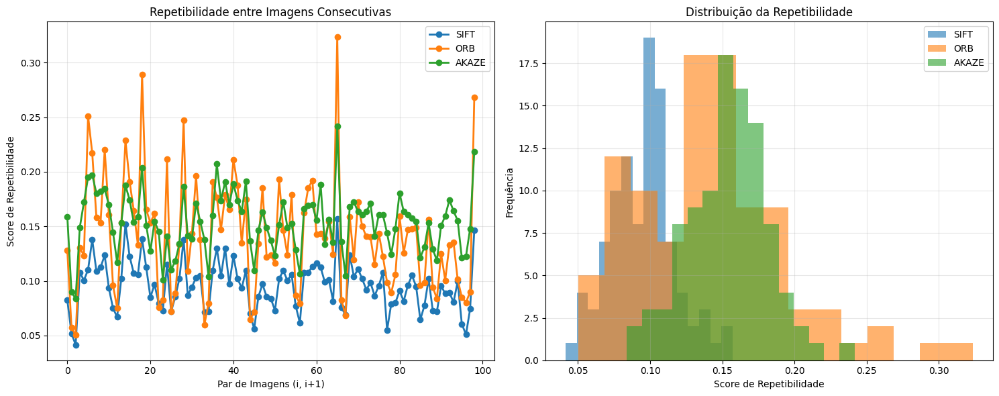

In [57]:
def calculate_repeatability(features_dict, distance_threshold=3.0):
    image_names = sorted(features_dict.keys())
    repeatability_scores = []
    
    for i in range(len(image_names) - 1):
        img1_name = image_names[i]
        img2_name = image_names[i + 1]
        
        kp1 = features_dict[img1_name]['keypoints']
        kp2 = features_dict[img2_name]['keypoints']
        
        if not kp1 or not kp2:
            continue
        
        pts1 = np.array([kp.pt for kp in kp1])
        pts2 = np.array([kp.pt for kp in kp2])
        
        # Usando distância euclidiana
        matches = 0
        for pt1 in pts1:
            distances = np.linalg.norm(pts2 - pt1, axis=1)
            if np.min(distances) < distance_threshold:
                matches += 1
        
        repeatability = matches / len(pts1) if len(pts1) > 0 else 0
        repeatability_scores.append(repeatability)
    
    return repeatability_scores

print("=== ANÁLISE DE REPETIBILIDADE ===")
print("Consistência de detecção entre imagens consecutivas")

repeatability_results = {}
for detector_name, features_dict in [('SIFT', sift_features), 
                                    ('ORB', orb_features),
                                    ('AKAZE', akaze_features)]:
    print(f"\nCalculando repetibilidade para {detector_name}...")
    repeatability_scores = calculate_repeatability(features_dict)
    repeatability_results[detector_name] = repeatability_scores
    
    if repeatability_scores:
        mean_repeat = np.mean(repeatability_scores)
        std_repeat = np.std(repeatability_scores)
        
        print(f"  Repetibilidade média: {mean_repeat:.3f} ± {std_repeat:.3f}")
        print(f"  Melhor par: {max(repeatability_scores):.3f}")
        print(f"  Pior par: {min(repeatability_scores):.3f}")
        

# Visualização e scores
fig, axes = plt.subplots(1, 2, figsize=(15, 6))

for i, (detector, scores) in enumerate(repeatability_results.items()):
    if scores:
        axes[0].plot(scores, 'o-', label=detector, linewidth=2, markersize=6)

axes[0].set_title('Repetibilidade entre Imagens Consecutivas')
axes[0].set_xlabel('Par de Imagens (i, i+1)')
axes[0].set_ylabel('Score de Repetibilidade')
axes[0].grid(True, alpha=0.3)
axes[0].legend()

# Histogram of repeatability
for detector, scores in repeatability_results.items():
    if scores:
        axes[1].hist(scores, alpha=0.6, label=detector, bins=15)

axes[1].set_title('Distribuição da Repetibilidade')
axes[1].set_xlabel('Score de Repetibilidade')
axes[1].set_ylabel('Frequência')
axes[1].grid(True, alpha=0.3)
axes[1].legend()

plt.tight_layout()
plt.show()

In [58]:
print("=" * 60)
print("=== COMPARAÇÃO FINAL ===")
print("=" * 60)

# Collect metrics from all detectors
final_comparison = {
    'SIFT': {
        'natural_capacity': natural_analysis['SIFT']['mean_natural'],
        'quality_score': natural_analysis['SIFT']['mean_quality'],
        'processing_time': natural_analysis['SIFT']['mean_time'],
        'repeatability': np.mean(repeatability_results['SIFT']) if repeatability_results['SIFT'] else 0
    },
    'ORB': {
        'natural_capacity': natural_analysis['ORB']['mean_natural'],
        'quality_score': natural_analysis['ORB']['mean_quality'],
        'processing_time': natural_analysis['ORB']['mean_time'],
        'repeatability': np.mean(repeatability_results['ORB']) if repeatability_results['ORB'] else 0
    },
    'AKAZE': {
        'natural_capacity': natural_analysis['AKAZE']['mean_natural'],
        'quality_score': natural_analysis['AKAZE']['mean_quality'],
        'processing_time': natural_analysis['AKAZE']['mean_time'],
        'repeatability': np.mean(repeatability_results['AKAZE']) if repeatability_results['AKAZE'] else 0
    }
}

# Sistema de score
scoring_weights = {
    'quality': 0.4,      
    'repeatability': 0.3, 
    'efficiency': 0.2,    
    'capacity': 0.1      
}

def normalize_score(value, min_val, max_val):
    if max_val == min_val:
        return 0.5
    return (value - min_val) / (max_val - min_val)

# Extract values for normalization
qualities = [data['quality_score'] for data in final_comparison.values()]
times = [data['processing_time'] for data in final_comparison.values()]
capacities = [data['natural_capacity'] for data in final_comparison.values()]
repeatabilities = [data['repeatability'] for data in final_comparison.values()]

# Calculate final scores
final_scores = {}
for detector, data in final_comparison.items():
    # Normalize metrics (0-1)
    quality_norm = normalize_score(data['quality_score'], min(qualities), max(qualities))
    efficiency_norm = 1 - normalize_score(data['processing_time'], min(times), max(times))  
    capacity_norm = normalize_score(data['natural_capacity'], min(capacities), max(capacities))
    repeat_norm = normalize_score(data['repeatability'], min(repeatabilities), max(repeatabilities))
    
    # Weighted score
    final_score = (
        quality_norm * scoring_weights['quality'] +
        repeat_norm * scoring_weights['repeatability'] +
        efficiency_norm * scoring_weights['efficiency'] +
        capacity_norm * scoring_weights['capacity']
    )
    
    final_scores[detector] = {
        'total_score': final_score,
        'quality_norm': quality_norm,
        'efficiency_norm': efficiency_norm,
        'capacity_norm': capacity_norm,
        'repeat_norm': repeat_norm
    }

print(f"{'Detector':<10} {'Qualidade':<12} {'Repetib.':<10} {'Eficiência':<12} {'Capacidade':<12} {'SCORE FINAL':<12}")
print("-" * 80)

for detector in ['SIFT', 'ORB', 'AKAZE']:
    data = final_comparison[detector]
    scores = final_scores[detector]
    
    print(f"{detector:<10} "
          f"{data['quality_score']:.4f}      "
          f"{data['repeatability']:.3f}     "
          f"{data['processing_time']:.3f}s       "
          f"{data['natural_capacity']:.0f}        "
          f"{scores['total_score']:.3f}")

# Ranking
ranked_detectors = sorted(final_scores.items(), key=lambda x: x[1]['total_score'], reverse=True)

print(f"\nRANKING FINAL:")
for rank, (detector, scores) in enumerate(ranked_detectors, 1):
    print(f"  {rank}. {detector}: {scores['total_score']:.3f}/1.000")

# Recomendação final
winner = ranked_detectors[0][0]
print(f"\nRECOMENDAÇÃO BASEADA NOS SCORES:")
print(f"  Recomendação: {winner}")
print(f"  Score final: {ranked_detectors[0][1]['total_score']:.3f}/1.000")

=== COMPARAÇÃO FINAL ===
Detector   Qualidade    Repetib.   Eficiência   Capacidade   SCORE FINAL 
--------------------------------------------------------------------------------
SIFT       0.0229      0.096     0.157s       5845        0.440
ORB        0.0001      0.141     0.028s       10000        0.533
AKAZE      0.0034      0.154     0.089s       3022        0.464

RANKING FINAL:
  1. ORB: 0.533/1.000
  2. AKAZE: 0.464/1.000
  3. SIFT: 0.440/1.000

RECOMENDAÇÃO BASEADA NOS SCORES:
  Recomendação: ORB
  Score final: 0.533/1.000


## Comparação Detalhada de Matches: Detectores vs Matchers

In [59]:
# Seleciona duas imagens específicas para comparação detalhada
img1_name = list(images.keys())[10]  # Primeira imagem
img2_name = list(images.keys())[12]  # Imagem 12 (mais próxima)

img1 = images[img1_name]
img2 = images[img2_name]

print(f"Analisando matches entre:")
print(f"  Imagem 1: {img1_name} - {img1.shape}")  
print(f"  Imagem 2: {img2_name} - {img2.shape}")

# Extrai características de ambas as imagens com os três detectores
detectors_for_matching = {}

print(f"\nExtraindo características para análise de matches...")

# SIFT
print("Extraindo SIFT...")
sift_img1 = feature_extraction.extract_features_from_image_set(
    {img1_name: img1}, "SIFT", nfeatures=2000
)
sift_img2 = feature_extraction.extract_features_from_image_set(
    {img2_name: img2}, "SIFT", nfeatures=2000
)
detectors_for_matching['SIFT'] = {
    'img1': sift_img1[img1_name],
    'img2': sift_img2[img2_name]
}

# ORB  
print("Extraindo ORB...")
orb_img1 = feature_extraction.extract_features_from_image_set(
    {img1_name: img1}, "ORB", nfeatures=3000
)
orb_img2 = feature_extraction.extract_features_from_image_set(
    {img2_name: img2}, "ORB", nfeatures=3000
)
detectors_for_matching['ORB'] = {
    'img1': orb_img1[img1_name],
    'img2': orb_img2[img2_name]
}

# AKAZE
print("Extraindo AKAZE...")
akaze_img1 = feature_extraction.extract_features_from_image_set(
    {img1_name: img1}, "AKAZE"
)
akaze_img2 = feature_extraction.extract_features_from_image_set(
    {img2_name: img2}, "AKAZE"
)
detectors_for_matching['AKAZE'] = {
    'img1': akaze_img1[img1_name],
    'img2': akaze_img2[img2_name]
}

print(f"\nCaracterísticas extraídas:")
for detector, data in detectors_for_matching.items():
    kp1_count = len(data['img1'][0]) if data['img1'][0] else 0
    kp2_count = len(data['img2'][0]) if data['img2'][0] else 0
    print(f"  {detector}: {kp1_count} + {kp2_count} keypoints")

Analisando matches entre:
  Imagem 1: 18 - (1280, 720, 3)
  Imagem 2: 2 - (1280, 720, 3)

Extraindo características para análise de matches...
Extraindo SIFT...
Extracting SIFT features from 1 images...


Extracting SIFT: 100%|██████████| 1/1 [00:00<00:00,  7.91image/s]


  18: 2000 keypoints
Extracting SIFT features from 1 images...


Extracting SIFT: 100%|██████████| 1/1 [00:00<00:00,  7.95image/s]


  2: 2000 keypoints
Extraindo ORB...
Extracting ORB features from 1 images...


Extracting ORB: 100%|██████████| 1/1 [00:00<00:00, 56.51image/s]


  18: 3000 keypoints
Extracting ORB features from 1 images...


Extracting ORB: 100%|██████████| 1/1 [00:00<00:00, 53.20image/s]


  2: 3000 keypoints
Extraindo AKAZE...
Extracting AKAZE features from 1 images...


Extracting AKAZE: 100%|██████████| 1/1 [00:00<00:00, 11.48image/s]


  18: 3155 keypoints
Extracting AKAZE features from 1 images...


Extracting AKAZE: 100%|██████████| 1/1 [00:00<00:00, 12.11image/s]

  2: 3475 keypoints

Características extraídas:
  SIFT: 2000 + 2000 keypoints
  ORB: 3000 + 3000 keypoints
  AKAZE: 3155 + 3475 keypoints


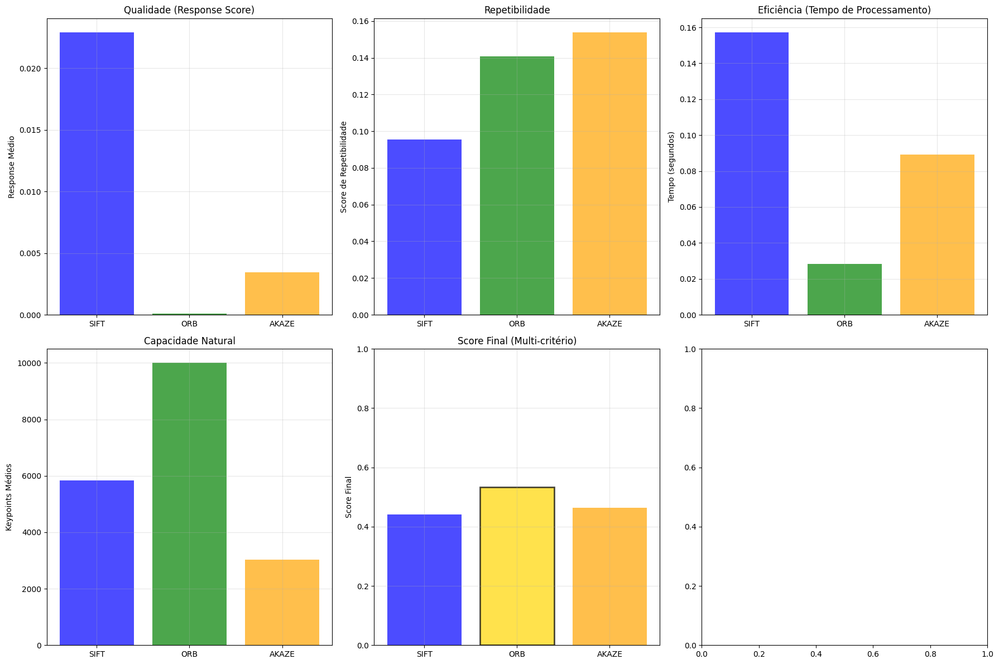

In [60]:
# Visualização da comparação
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

detectors = list(final_comparison.keys())
colors = ['blue', 'green', 'orange']

# Qualidade
qualities = [final_comparison[d]['quality_score'] for d in detectors]
axes[0,0].bar(detectors, qualities, alpha=0.7, color=colors)
axes[0,0].set_title('Qualidade (Response Score)')
axes[0,0].set_ylabel('Response Médio')
axes[0,0].grid(True, alpha=0.3)

# Repetibilidade
repeatabilities = [final_comparison[d]['repeatability'] for d in detectors]
axes[0,1].bar(detectors, repeatabilities, alpha=0.7, color=colors)
axes[0,1].set_title('Repetibilidade')
axes[0,1].set_ylabel('Score de Repetibilidade')
axes[0,1].grid(True, alpha=0.3)

# Eficiência (tempo de processamento)
times = [final_comparison[d]['processing_time'] for d in detectors]
axes[0,2].bar(detectors, times, alpha=0.7, color=colors)
axes[0,2].set_title('Eficiência (Tempo de Processamento)')
axes[0,2].set_ylabel('Tempo (segundos)')
axes[0,2].grid(True, alpha=0.3)

# Capacidade natural
capacities = [final_comparison[d]['natural_capacity'] for d in detectors]
axes[1,0].bar(detectors, capacities, alpha=0.7, color=colors)
axes[1,0].set_title('Capacidade Natural')
axes[1,0].set_ylabel('Keypoints Médios')
axes[1,0].grid(True, alpha=0.3)

# Score final
final_score_values = [final_scores[d]['total_score'] for d in detectors]
bars = axes[1,1].bar(detectors, final_score_values, alpha=0.7, color=colors)
axes[1,1].set_title('Score Final (Multi-critério)')
axes[1,1].set_ylabel('Score Final')
axes[1,1].grid(True, alpha=0.3)
axes[1,1].set_ylim(0, 1)

winner_idx = detectors.index(winner)
bars[winner_idx].set_color('gold')
bars[winner_idx].set_edgecolor('black')
bars[winner_idx].set_linewidth(2)

plt.tight_layout()
plt.show()

## Visualizações Individuais de Keypoints

In [61]:
def generate_keypoint_visualizations(sample_images, output_base_dir):

    def draw_keypoints_on_image(image, keypoints, color=(0, 255, 0)):
        img_with_kp = image.copy()
        for kp in keypoints:
            x, y = int(kp.pt[0]), int(kp.pt[1])
            cv2.circle(img_with_kp, (x, y), 3, color, -1)
            if hasattr(kp, 'angle') and kp.angle != -1:
                end_x = int(x + 10 * np.cos(np.radians(kp.angle)))
                end_y = int(y + 10 * np.sin(np.radians(kp.angle)))
                cv2.line(img_with_kp, (x, y), (end_x, end_y), color, 1)
        return img_with_kp
    
    # Seleciona uma amostra representativa de imagens para visualização
    visualization_sample = sample_images[:10]  # Primeiras 10 imagens
    
    colors = {
        'SIFT': (255, 0, 0),    # Vermelho
        'ORB': (0, 255, 0),     # Verde
        'AKAZE': (0, 0, 255)    # Azul
    }
    
    for detector_name in ['SIFT', 'ORB', 'AKAZE']:
        print(f"\n=== Gerando visualizações para {detector_name} ===")
        
        # Cria diretório para as visualizações deste detector
        vis_dir = os.path.join(output_base_dir, "S2-hpbv-keypoints-visualization")
        os.makedirs(vis_dir, exist_ok=True)
        
        for i, img_name in enumerate(visualization_sample):
            try:
                # Carrega a imagem diretamente do dicionário
                img = images[img_name]
                
                # Extrai features para esta imagem específica
                if detector_name == "SIFT":
                    detector = cv2.SIFT_create(nfeatures=500)  # Limite razoável para visualização
                elif detector_name == "ORB": 
                    detector = cv2.ORB_create(nfeatures=500)
                elif detector_name == "AKAZE":
                    detector = cv2.AKAZE_create()
                
                keypoints, descriptors = detector.detectAndCompute(img, None)
                
                # Desenha keypoints na imagem
                img_with_kp = draw_keypoints_on_image(img, keypoints, colors[detector_name])
                
                # Cria visualização
                plt.figure(figsize=(12, 8))
                img_with_kp_rgb = cv2.cvtColor(img_with_kp, cv2.COLOR_BGR2RGB)
                plt.imshow(img_with_kp_rgb)
                plt.title(f"{detector_name} - {len(keypoints)} keypoints", fontsize=16, fontweight='bold')
                plt.axis('off')
                
                # Salva a visualização
                output_path = os.path.join(vis_dir, f"{detector_name}_{i+1}_keypoints.jpg")
                plt.savefig(output_path, bbox_inches='tight', dpi=150)
                plt.close()
                
                print(f"  {img_name}: {len(keypoints)} keypoints -> {output_path}")
                
            except Exception as e:
                print(f"  Erro ao processar {img_name}: {e}")

# Executa as visualizações individuais
if len(list(images.keys())) > 0:
    sample_names = list(images.keys())
    print("Gerando visualizações individuais de keypoints...")
    generate_keypoint_visualizations(
        sample_names,
        f"../../data/T2/interim/{SELECTED_OBJECT}"
    )
else:
    print("Nenhuma imagem disponível para visualização")

Gerando visualizações individuais de keypoints...

=== Gerando visualizações para SIFT ===
  1: 501 keypoints -> ../../data/T2/interim/galinha_honduras/S2-hpbv-keypoints-visualization/SIFT_1_keypoints.jpg
  10: 500 keypoints -> ../../data/T2/interim/galinha_honduras/S2-hpbv-keypoints-visualization/SIFT_2_keypoints.jpg
  100: 501 keypoints -> ../../data/T2/interim/galinha_honduras/S2-hpbv-keypoints-visualization/SIFT_3_keypoints.jpg
  11: 500 keypoints -> ../../data/T2/interim/galinha_honduras/S2-hpbv-keypoints-visualization/SIFT_4_keypoints.jpg
  12: 500 keypoints -> ../../data/T2/interim/galinha_honduras/S2-hpbv-keypoints-visualization/SIFT_5_keypoints.jpg
  13: 501 keypoints -> ../../data/T2/interim/galinha_honduras/S2-hpbv-keypoints-visualization/SIFT_6_keypoints.jpg
  14: 500 keypoints -> ../../data/T2/interim/galinha_honduras/S2-hpbv-keypoints-visualization/SIFT_7_keypoints.jpg
  15: 500 keypoints -> ../../data/T2/interim/galinha_honduras/S2-hpbv-keypoints-visualization/SIFT_8_key

## Comparação lado a lado dos detectores


=== Gerando comparações lado a lado dos detectores ===


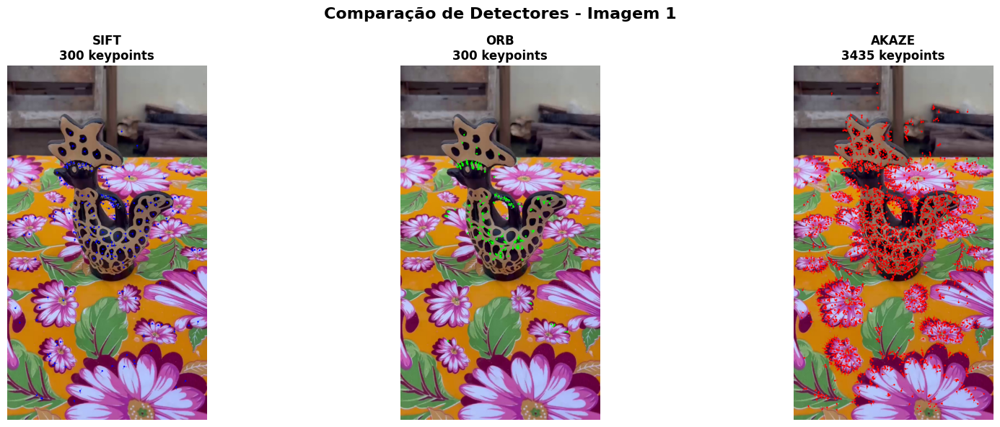

  1: SIFT=300, ORB=300, AKAZE=3435 -> ../../data/T2/interim/galinha_honduras/S2-hpbv-detector-comparison/detector_comparison_1.jpg


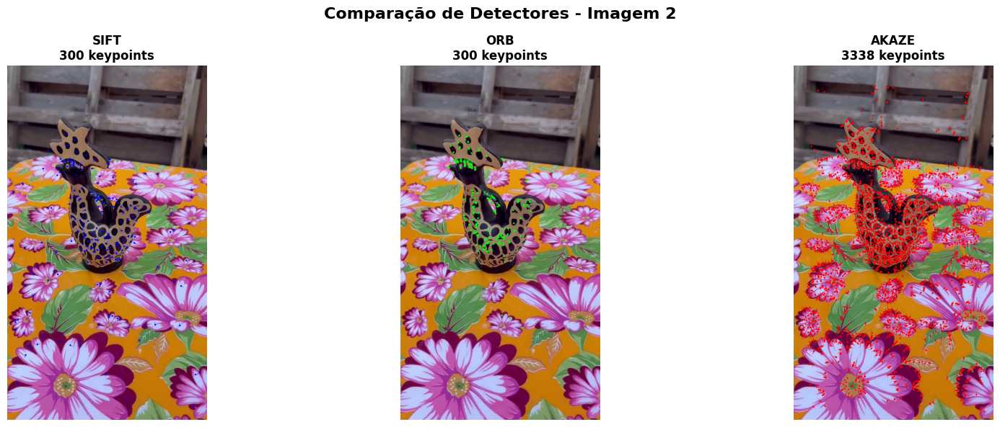

  10: SIFT=300, ORB=300, AKAZE=3338 -> ../../data/T2/interim/galinha_honduras/S2-hpbv-detector-comparison/detector_comparison_2.jpg


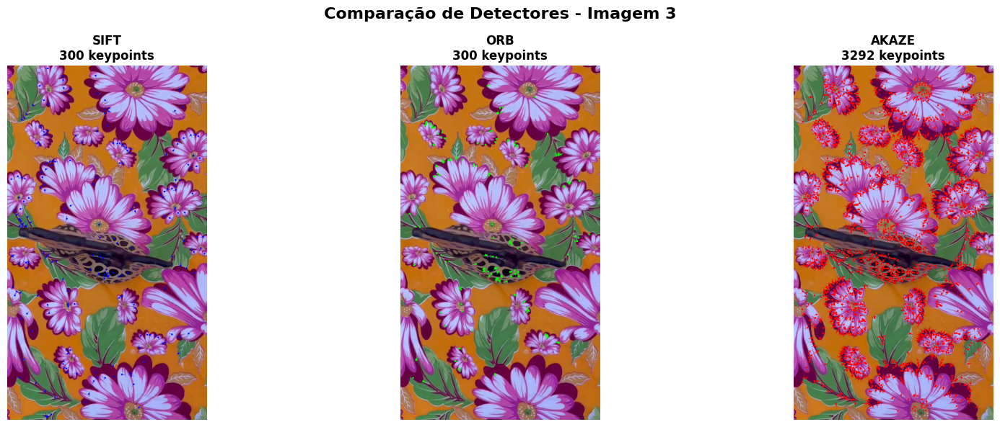

  100: SIFT=300, ORB=300, AKAZE=3292 -> ../../data/T2/interim/galinha_honduras/S2-hpbv-detector-comparison/detector_comparison_3.jpg


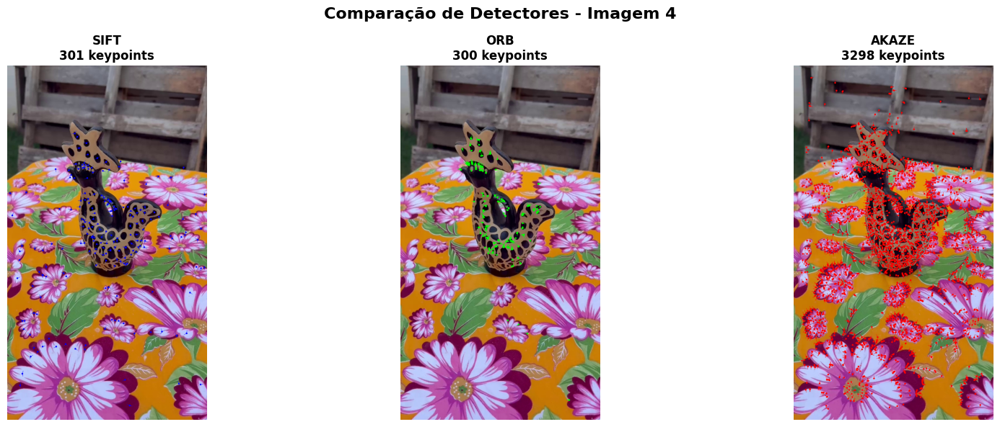

  11: SIFT=301, ORB=300, AKAZE=3298 -> ../../data/T2/interim/galinha_honduras/S2-hpbv-detector-comparison/detector_comparison_4.jpg


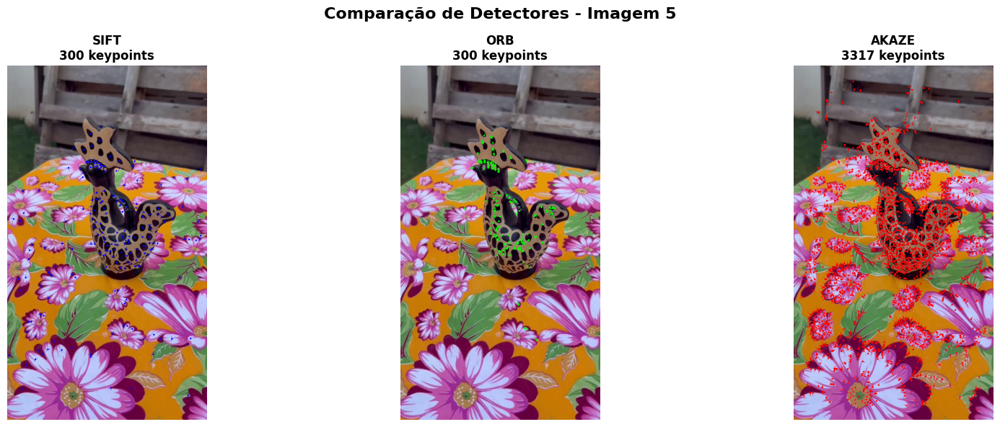

  12: SIFT=300, ORB=300, AKAZE=3317 -> ../../data/T2/interim/galinha_honduras/S2-hpbv-detector-comparison/detector_comparison_5.jpg


In [62]:
def generate_detector_comparisons(sample_images, output_base_dir):

    import matplotlib.pyplot as plt
    import os
    import cv2
    import numpy as np
    
    def draw_keypoints_on_image(image, keypoints, color=(0, 255, 0)):
        img_with_kp = image.copy()
        for kp in keypoints:
            x, y = int(kp.pt[0]), int(kp.pt[1])
            cv2.circle(img_with_kp, (x, y), 3, color, -1)
            if hasattr(kp, 'angle') and kp.angle != -1:
                end_x = int(x + 10 * np.cos(np.radians(kp.angle)))
                end_y = int(y + 10 * np.sin(np.radians(kp.angle)))
                cv2.line(img_with_kp, (x, y), (end_x, end_y), color, 1)
        return img_with_kp
    
    save_dir = f"../../data/T2/interim/{SELECTED_OBJECT}/S2-hpbv-detector-comparison"
    os.makedirs(save_dir, exist_ok=True)
    
    # Seleciona algumas imagens representativas para comparação
    comparison_sample = sample_images[:5]  # Primeiras 5 imagens
    
    print("\n=== Gerando comparações lado a lado dos detectores ===")
    
    colors = {
        'SIFT': (255, 0, 0),    # Vermelho
        'ORB': (0, 255, 0),     # Verde  
        'AKAZE': (0, 0, 255)    # Azul
    }
    
    for i, img_name in enumerate(comparison_sample):
        try:
            img = images[img_name]
            
            sift_detector = cv2.SIFT_create(nfeatures=300)
            orb_detector = cv2.ORB_create(nfeatures=300)
            akaze_detector = cv2.AKAZE_create()
            
            # Extrai keypoints para cada detector
            sift_kp, _ = sift_detector.detectAndCompute(img, None)
            orb_kp, _ = orb_detector.detectAndCompute(img, None)
            akaze_kp, _ = akaze_detector.detectAndCompute(img, None)
            
            # Cria figura com 3 subplots
            fig, axes = plt.subplots(1, 3, figsize=(18, 6))
            fig.suptitle(f'Comparação de Detectores - Imagem {i+1}', fontsize=16, fontweight='bold')
            
            detector_names = ['SIFT', 'ORB', 'AKAZE']
            keypoints_list = [sift_kp, orb_kp, akaze_kp]
            
            for j, (detector_name, keypoints) in enumerate(zip(detector_names, keypoints_list)):
                # Desenha keypoints na imagem
                img_with_kp = draw_keypoints_on_image(img, keypoints, colors[detector_name])
                img_with_kp_rgb = cv2.cvtColor(img_with_kp, cv2.COLOR_BGR2RGB)
                
                # Mostra no subplot
                axes[j].imshow(img_with_kp_rgb)
                axes[j].set_title(f'{detector_name}\n{len(keypoints)} keypoints', fontweight='bold')
                axes[j].axis('off')
            
            # Ajusta layout e salva
            plt.tight_layout()
            output_path = os.path.join(save_dir, f"detector_comparison_{i+1}.jpg")
            plt.savefig(output_path, bbox_inches='tight', dpi=150)
            plt.show()
            plt.close()
            
            print(f"  {img_name}: SIFT={len(sift_kp)}, ORB={len(orb_kp)}, AKAZE={len(akaze_kp)} -> {output_path}")
            
        except Exception as e:
            print(f"  Erro ao processar {img_name}: {e}")

# Executa as comparações lado a lado
if len(list(images.keys())) > 0:
    sample_names = list(images.keys())
    generate_detector_comparisons(sample_names, f"../../data/T2/interim/{SELECTED_OBJECT}")
else:
    print("Nenhuma imagem disponível para comparação")

## Visualização de matches


=== Análise Detalhada de Matching Lado a Lado ===
Analisando par: 18 ↔ 2

Extraindo features com SIFT...
  SIFT: 2000 + 2000 keypoints

Extraindo features com ORB...
  ORB: 3000 + 3000 keypoints

Extraindo features com AKAZE...
  AKAZE: 3155 + 3475 keypoints
Realizando análise COMPLETA de matches (keypoints + correspondências)...

Analisando SIFT...
  SIFT-BF: 254 matches | KP1: 2000 | KP2: 2000
  SIFT-FLANN: 270 matches | KP1: 2000 | KP2: 2000

Analisando ORB...
  ORB-BF: 143 matches | KP1: 3000 | KP2: 3000
  ORB-FLANN: 164 matches | KP1: 3000 | KP2: 3000

Analisando AKAZE...
  AKAZE-BF: 164 matches | KP1: 3155 | KP2: 3475
  AKAZE-FLANN: 184 matches | KP1: 3155 | KP2: 3475


COMPARAÇÃO COMPLETA: Brute Force Matcher com SIFT, ORB e AKAZE
 SIFT + BF: 254 matches | KP: 2000+2000
 ORB + BF: 143 matches | KP: 3000+3000
 AKAZE + BF: 164 matches | KP: 3155+3475


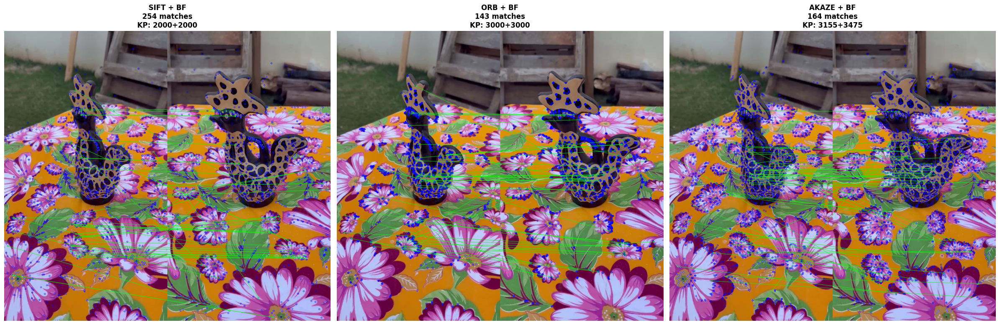


Comparação BF salva: ../../data/T2/interim/galinha_honduras/S2-hpbv-matcher-comparison/BFComparison.png

COMPARAÇÃO COMPLETA: FLANN Matcher com SIFT, ORB e AKAZE
 SIFT + FLANN: 270 matches | KP: 2000+2000
 ORB + FLANN: 164 matches | KP: 3000+3000
 AKAZE + FLANN: 184 matches | KP: 3155+3475


<Figure size 640x480 with 0 Axes>

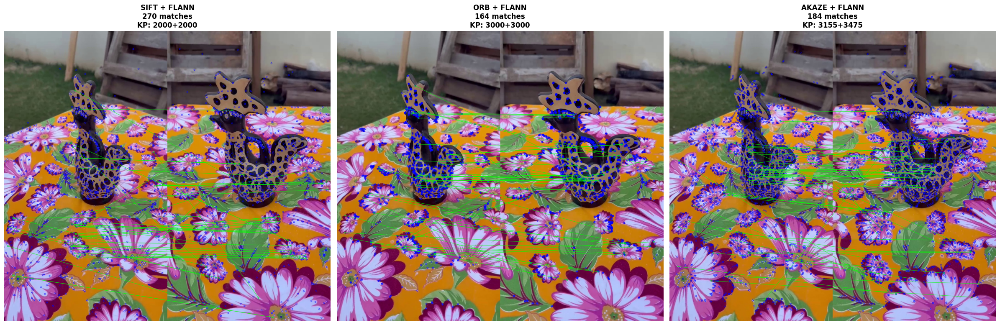


Comparação FLANN salva: ../../data/T2/interim/galinha_honduras/S2-hpbv-matcher-comparison/FlannComparison.png

GERANDO VISUALIZAÇÕES INDIVIDUAIS DETECTOR+MATCHER


<Figure size 640x480 with 0 Axes>

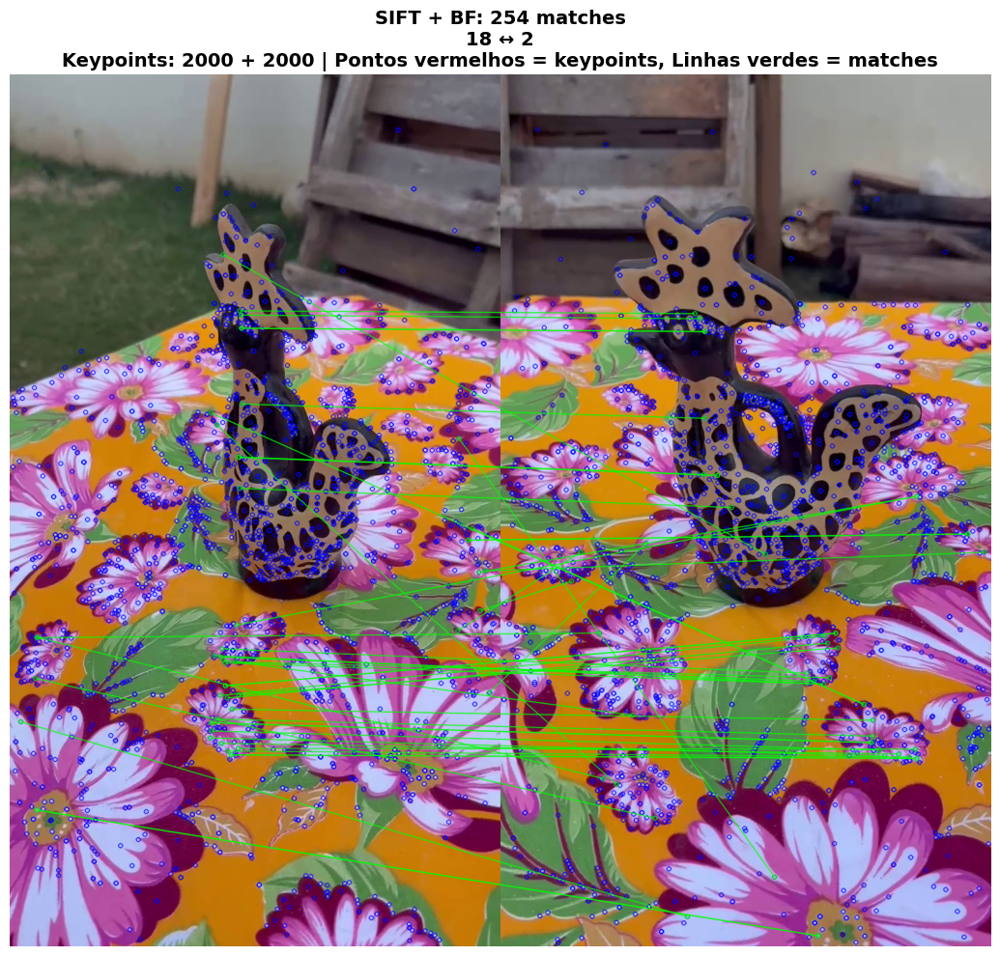

  SIFT+BF: 254 matches -> ../../data/T2/interim/galinha_honduras/S2-hpbv-matcher-comparison/SIFT-BFMatcher-pair.jpg


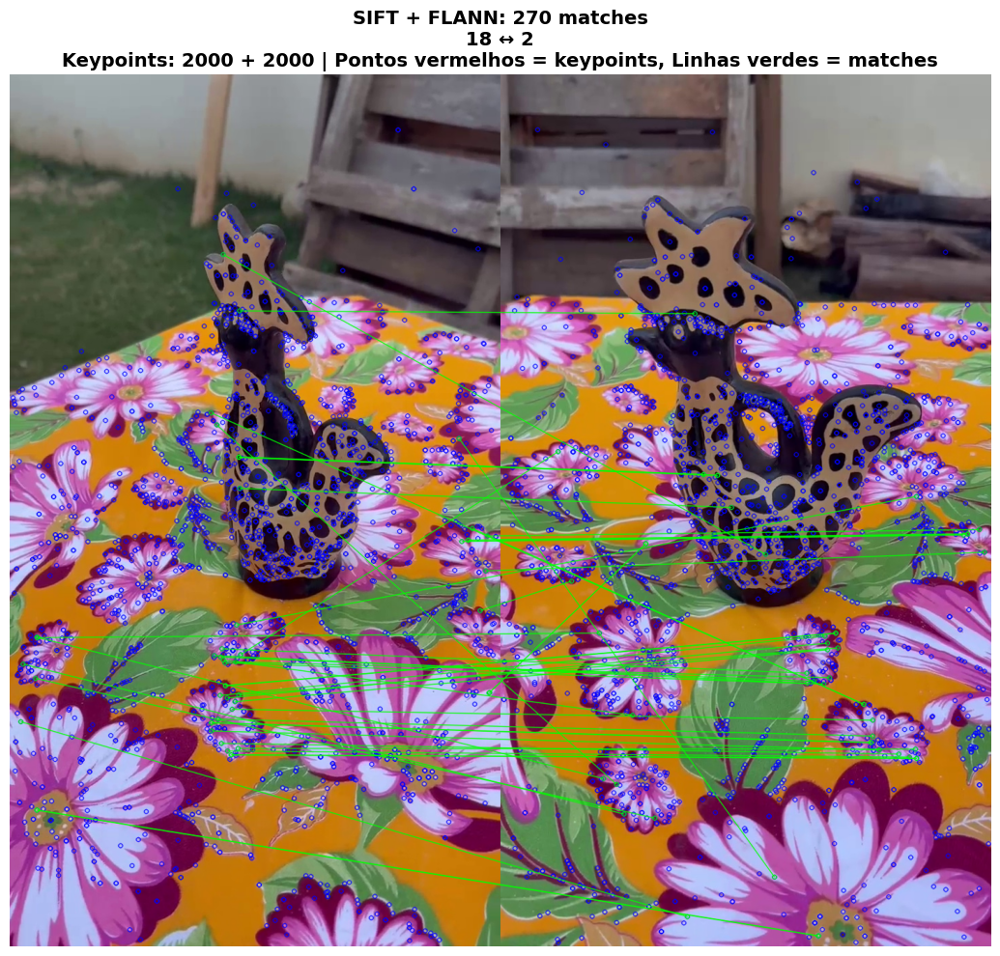

  SIFT+FLANN: 270 matches -> ../../data/T2/interim/galinha_honduras/S2-hpbv-matcher-comparison/SIFT-FLANNMatcher-pair.jpg


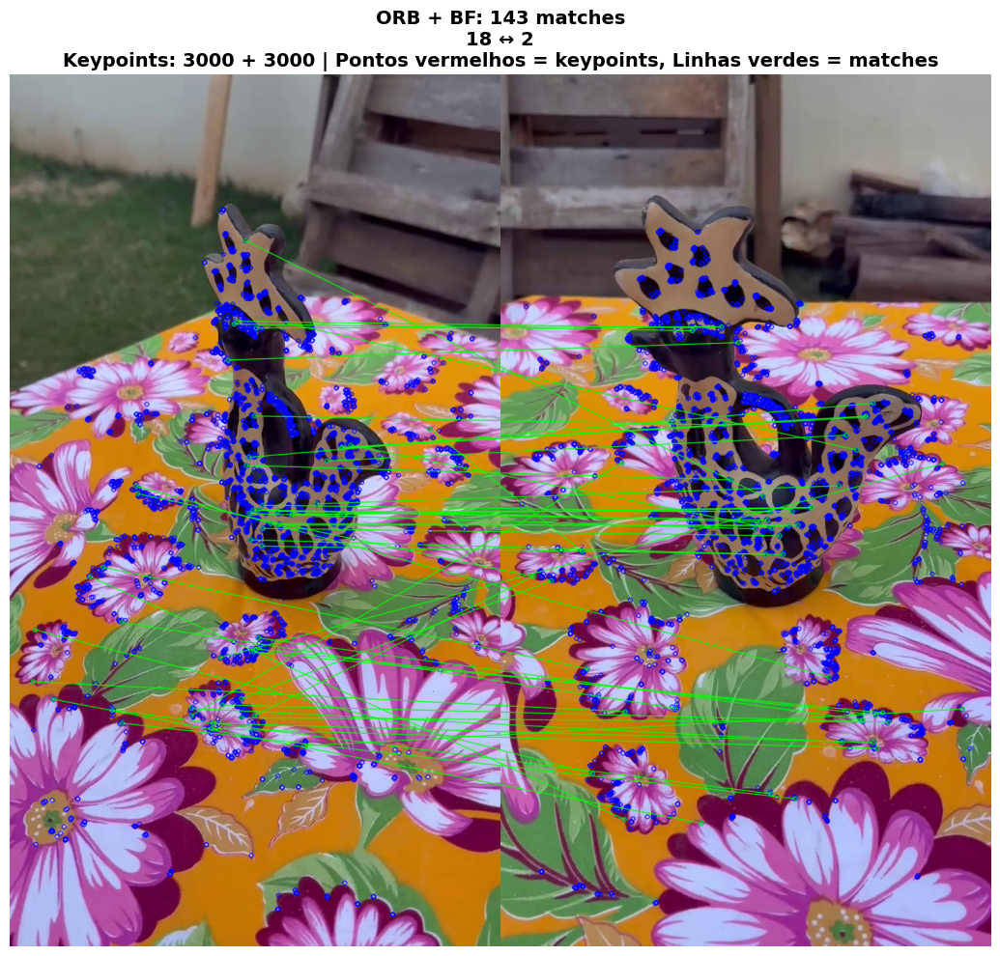

  ORB+BF: 143 matches -> ../../data/T2/interim/galinha_honduras/S2-hpbv-matcher-comparison/ORB-BFMatcher-pair.jpg


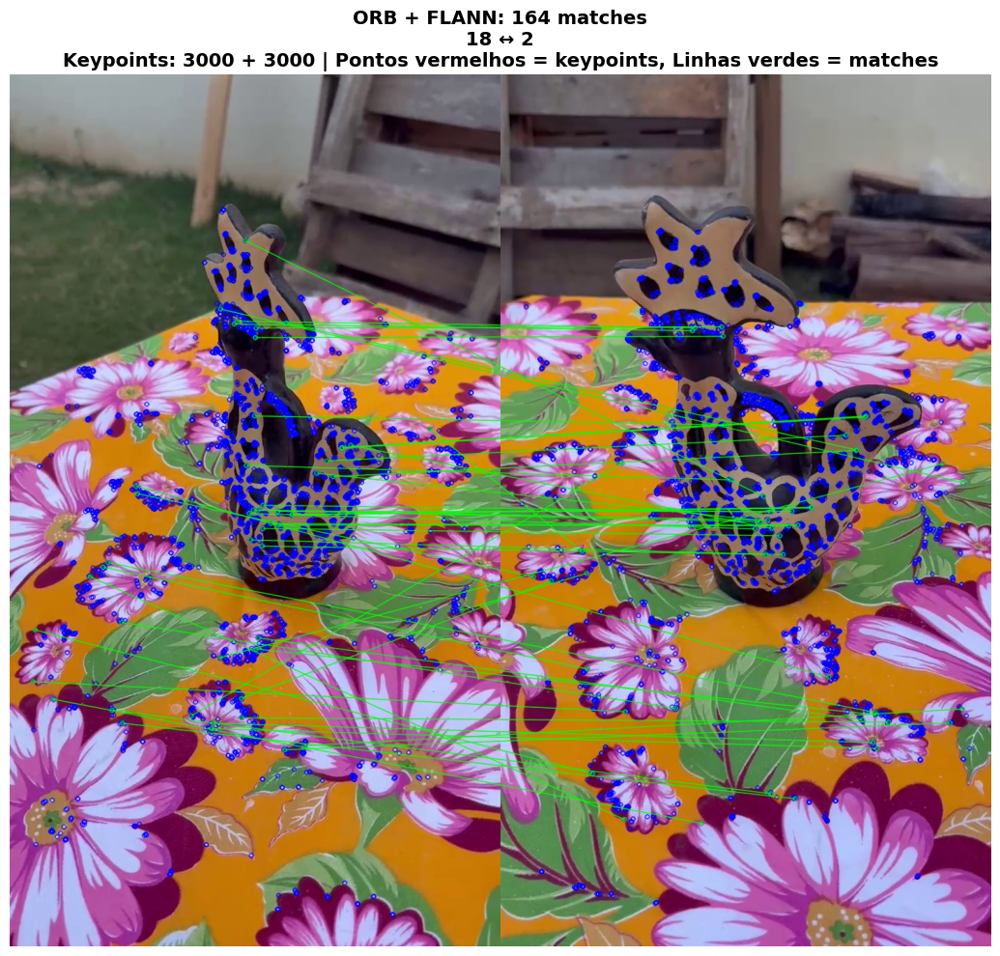

  ORB+FLANN: 164 matches -> ../../data/T2/interim/galinha_honduras/S2-hpbv-matcher-comparison/ORB-FLANNMatcher-pair.jpg


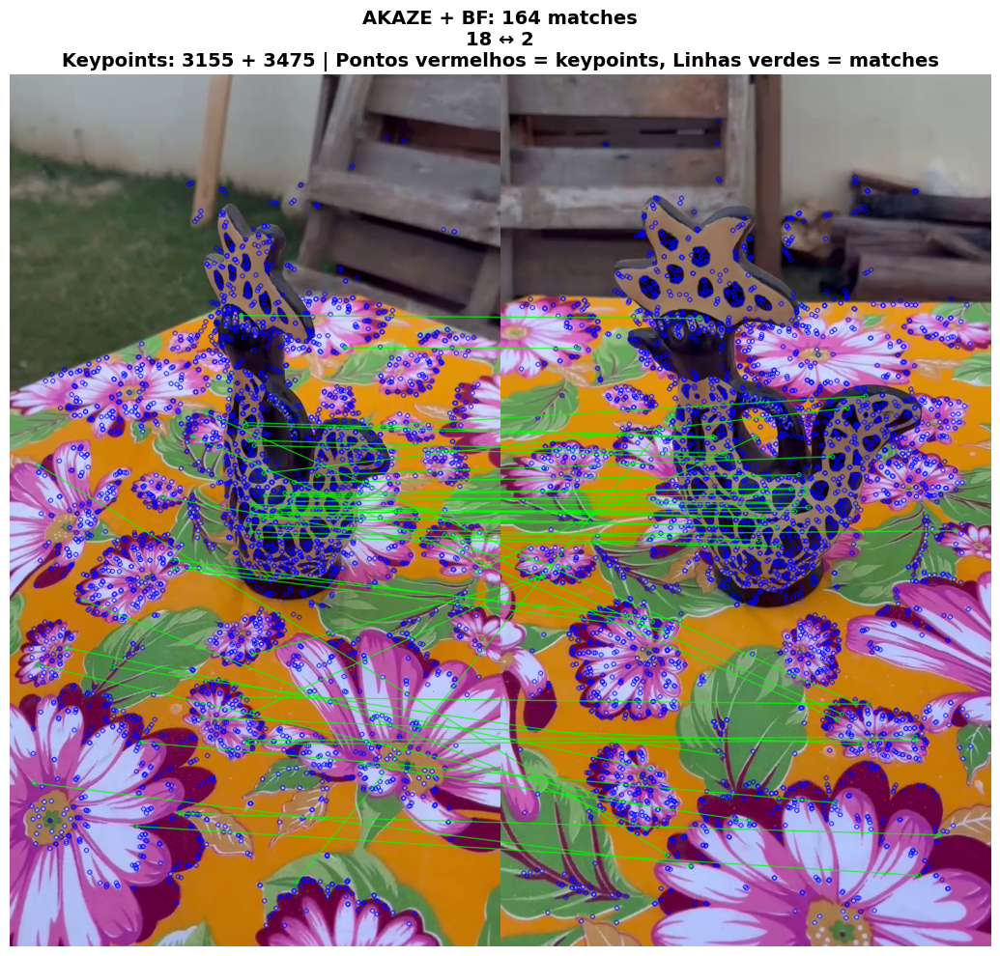

  AKAZE+BF: 164 matches -> ../../data/T2/interim/galinha_honduras/S2-hpbv-matcher-comparison/AKAZE-BFMatcher-pair.jpg


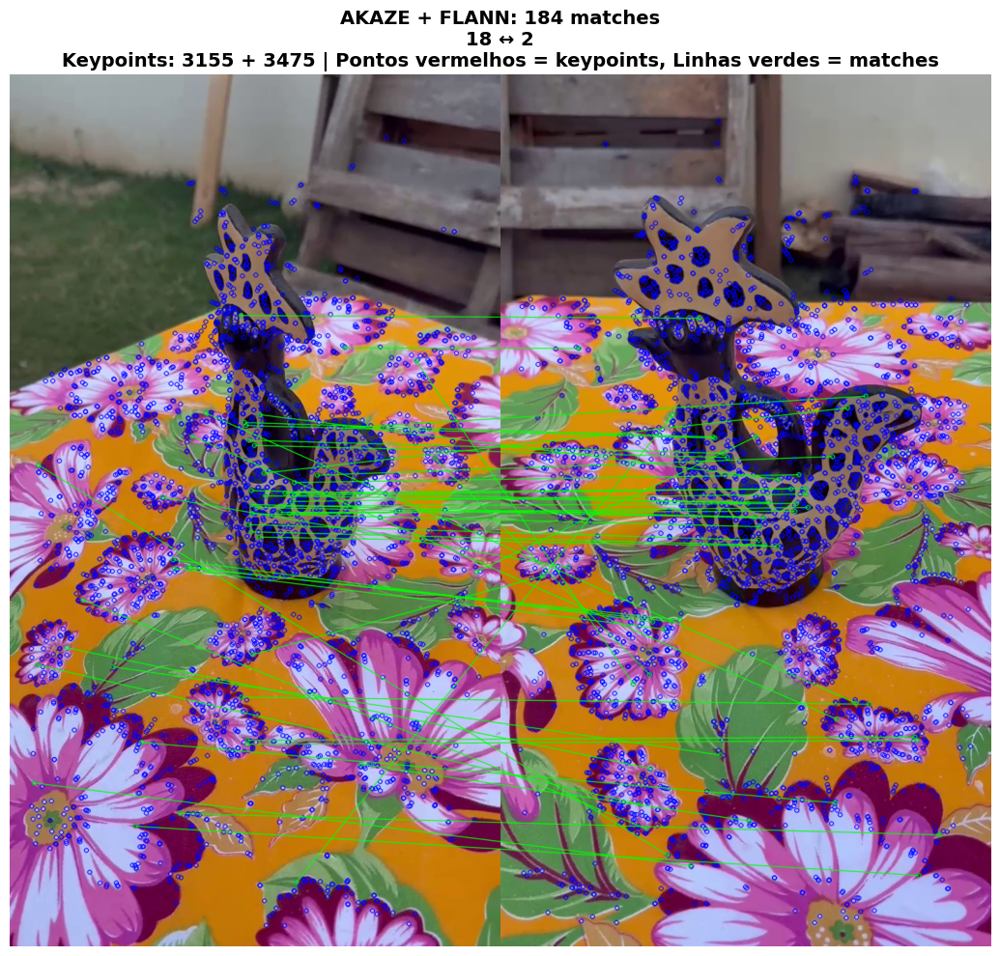

  AKAZE+FLANN: 184 matches -> ../../data/T2/interim/galinha_honduras/S2-hpbv-matcher-comparison/AKAZE-FLANNMatcher-pair.jpg

RESUMO FINAL DA ANÁLISE DETALHADA DE MATCHING
Par analisado: 18 ↔ 2
Detector+Matcher     Matches  KP Img1  KP Img2  Eficiência
------------------------------------------------------------
SIFT+BF              254      2000     2000     6.3%      
SIFT+FLANN           270      2000     2000     6.8%      
ORB+BF               143      3000     3000     2.4%      
ORB+FLANN            164      3000     3000     2.7%      
AKAZE+BF             164      3155     3475     2.5%      
AKAZE+FLANN          184      3155     3475     2.8%      
------------------------------------------------------------
Melhor combinação: SIFT+FLANN (270 matches)


In [ ]:
def generate_detailed_matching_analysis(sample_images, output_base_dir):
    
    if len(sample_images) < 2:
        print("Necessário pelo menos 2 imagens para análise de matching")
        return {}
    
    detailed_dir = f"../../data/T2/interim/{SELECTED_OBJECT}/S2-hpbv-matcher-comparison"
    comparing_dir = f"../../data/T2/interim/{SELECTED_OBJECT}/S2-hpbv-matcher-comparison"
    os.makedirs(detailed_dir, exist_ok=True)
    os.makedirs(comparing_dir, exist_ok=True)
    
    # Seleciona duas imagens para análise detalhada
    img1_name = sample_images[10] if len(sample_images) > 10 else sample_images[0]  
    img2_name = sample_images[12] if len(sample_images) > 12 else sample_images[1]  
    
    img1 = images[img1_name]
    img2 = images[img2_name]
    
    print(f"\n=== Análise Detalhada de Matching Lado a Lado ===")
    print(f"Analisando par: {img1_name} ↔ {img2_name}")
    
    # Define detectores com parâmetros otimizados para matching
    detectors_config = {
        'SIFT': cv2.SIFT_create(nfeatures=2000, contrastThreshold=0.03),
        'ORB': cv2.ORB_create(nfeatures=3000),
        'AKAZE': cv2.AKAZE_create()
    }
    
    # Extrai features para todas as combinações
    detectors_for_matching = {}
    
    for det_name, detector in detectors_config.items():
        print(f"\nExtraindo features com {det_name}...")
        
        # Extrai features das duas imagens
        kp1, desc1 = detector.detectAndCompute(img1, None)
        kp2, desc2 = detector.detectAndCompute(img2, None)
        
        detectors_for_matching[det_name] = {
            'img1': (kp1, desc1),
            'img2': (kp2, desc2)
        }
        
        print(f"  {det_name}: {len(kp1) if kp1 else 0} + {len(kp2) if kp2 else 0} keypoints")
    
    def create_enhanced_match_visualization(img1, img2, kp1, kp2, matches, title, max_matches=50):
        # Limita número de matches para visualização mais limpa
        display_matches = matches[:max_matches] if len(matches) > max_matches else matches
        
        img_matches = cv2.drawMatches(
            img1, kp1, img2, kp2, display_matches,
            None,
            flags=cv2.DrawMatchesFlags_DEFAULT,  # Mostra todos os keypoints
            matchColor=(0, 255, 0),      # Verde para matches
            singlePointColor=(255, 0, 0), # Vermelho para keypoints sem correspondentes
            matchesMask=None
        )
        
        return img_matches
    
    # Função para análise de matching enhanced
    def perform_matching_analysis_enhanced(detector_name, features1, features2, img1, img2):
        kp1, desc1 = features1
        kp2, desc2 = features2
        
        if desc1 is None or desc2 is None:
            return {'BF': None, 'FLANN': None}
        
        results = {}
        
        if detector_name == 'SIFT':
            # SIFT usa descritores float32
            matchers = {
                'BF': cv2.BFMatcher(cv2.NORM_L2, crossCheck=False),
                'FLANN': cv2.FlannBasedMatcher(
                    dict(algorithm=1, trees=5),  # KDTREE
                    dict(checks=50)
                )
            }
        else:  # ORB, AKAZE
            # Descritores binários
            matchers = {
                'BF': cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=False),
                'FLANN': cv2.FlannBasedMatcher(
                    dict(algorithm=6, table_number=6, key_size=12, multi_probe_level=1),  # LSH
                    dict(checks=50)
                )
            }
        
        # Testar ambos os matchers
        for matcher_name, matcher in matchers.items():
            try:
                # Realiza matching com ratio test de Lowe
                raw_matches = matcher.knnMatch(desc1, desc2, k=2)
                
                good_matches = []
                if raw_matches:
                    for match_pair in raw_matches:
                        if len(match_pair) == 2:
                            m, n = match_pair
                            if m.distance < 0.75 * n.distance:  # Ratio test
                                good_matches.append(m)
                
                if len(good_matches) > 10:  # Só processa se tiver matches suficientes
                    img_matches = create_enhanced_match_visualization(
                        img1, img2, kp1, kp2, good_matches, 
                        f"{detector_name}-{matcher_name}"
                    )
                    
                    results[matcher_name] = {
                        'matches': good_matches,
                        'num_matches': len(good_matches),
                        'img_matches': img_matches,
                        'num_keypoints_img1': len(kp1),
                        'num_keypoints_img2': len(kp2),
                        'success': True
                    }
                else:
                    results[matcher_name] = {
                        'matches': [],
                        'num_matches': 0,
                        'img_matches': None,
                        'num_keypoints_img1': len(kp1) if kp1 else 0,
                        'num_keypoints_img2': len(kp2) if kp2 else 0,
                        'success': False
                    }
                    
            except Exception as e:
                print(f"  Erro com {detector_name}+{matcher_name}: {e}")
                results[matcher_name] = {
                    'matches': [],
                    'num_matches': 0,
                    'img_matches': None,
                    'num_keypoints_img1': len(kp1) if kp1 else 0,
                    'num_keypoints_img2': len(kp2) if kp2 else 0,
                    'success': False
                }
        
        return results
    
    # Realiza análise detalhada para todos os detectores
    print("Realizando análise COMPLETA de matches (keypoints + correspondências)...")
    print("="*70)
    
    matching_results = {}
    
    for detector_name in ['SIFT', 'ORB', 'AKAZE']:
        print(f"\nAnalisando {detector_name}...")
        
        data = detectors_for_matching[detector_name]
        features1 = data['img1']  # (keypoints, descriptors)
        features2 = data['img2']  # (keypoints, descriptors)
        
        analysis = perform_matching_analysis_enhanced(
            detector_name, features1, features2, img1, img2
        )
        
        matching_results[detector_name] = analysis
        
        # Mostra os resultados detalhados
        for matcher_name in ['BF', 'FLANN']:
            result = analysis[matcher_name]
            if result and result['success']:
                print(f"  {detector_name}-{matcher_name}: {result['num_matches']:3d} matches | "
                      f"KP1: {result['num_keypoints_img1']:3d} | KP2: {result['num_keypoints_img2']:3d}")
            else:
                kp1_count = result['num_keypoints_img1'] if result else 0
                kp2_count = result['num_keypoints_img2'] if result else 0
                print(f"  {detector_name}-{matcher_name}: Falha ou poucos matches | "
                      f"KP1: {kp1_count:3d} | KP2: {kp2_count:3d}")
    
    print("\n" + "="*70)
    print("="*70)
    
    print("\nCOMPARAÇÃO COMPLETA: Brute Force Matcher com SIFT, ORB e AKAZE")
    print("="*75)
    
    bf_detectors = ['SIFT', 'ORB', 'AKAZE']
    bf_matches = []
    bf_images = []
    bf_keypoints = []
    
    for detector in bf_detectors:
        if (matching_results[detector]['BF'] and 
            matching_results[detector]['BF']['success']):
            result = matching_results[detector]['BF']
            bf_matches.append(result['num_matches'])
            bf_images.append(result['img_matches'])
            bf_keypoints.append((result['num_keypoints_img1'], result['num_keypoints_img2']))
            print(f" {detector} + BF: {result['num_matches']:3d} matches | "
                  f"KP: {result['num_keypoints_img1']}+{result['num_keypoints_img2']}")
        else:
            print(f" {detector} + BF: Falha")
            bf_matches.append(0)
            bf_images.append(None)
            bf_keypoints.append((0, 0))
    
    # Criar subplot side-by-side com informações detalhadas
    fig, axes = plt.subplots(1, 3, figsize=(24, 8))
    
    for i, (detector, img, matches, kp_counts) in enumerate(zip(bf_detectors, bf_images, bf_matches, bf_keypoints)):
        if img is not None:
            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            axes[i].imshow(img_rgb)
            title = f'{detector} + BF\n{matches} matches\nKP: {kp_counts[0]}+{kp_counts[1]}'
            axes[i].set_title(title, fontsize=12, fontweight='bold')
        else:
            axes[i].text(0.5, 0.5, f'{detector} + BF\nFALHA', 
                        ha='center', va='center', transform=axes[i].transAxes,
                        fontsize=12, color='red', fontweight='bold')
        axes[i].axis('off')
    
    plt.tight_layout()
    plt.show()
    
    # Salvar comparação BF
    bf_comparison_path = os.path.join(comparing_dir, "BFComparison.png")
    plt.savefig(bf_comparison_path, dpi=150, bbox_inches='tight')
    print(f"\nComparação BF salva: {bf_comparison_path}")
    
    # 2. Comparação FLANN: SIFT, ORB, AKAZE lado a lado
    print("\nCOMPARAÇÃO COMPLETA: FLANN Matcher com SIFT, ORB e AKAZE")
    print("="*75)
    
    flann_detectors = ['SIFT', 'ORB', 'AKAZE']
    flann_matches = []
    flann_images = []
    flann_keypoints = []
    
    for detector in flann_detectors:
        if (matching_results[detector]['FLANN'] and 
            matching_results[detector]['FLANN']['success']):
            result = matching_results[detector]['FLANN']
            flann_matches.append(result['num_matches'])
            flann_images.append(result['img_matches'])
            flann_keypoints.append((result['num_keypoints_img1'], result['num_keypoints_img2']))
            print(f" {detector} + FLANN: {result['num_matches']:3d} matches | "
                  f"KP: {result['num_keypoints_img1']}+{result['num_keypoints_img2']}")
        else:
            print(f" {detector} + FLANN: Falha")
            flann_matches.append(0)
            flann_images.append(None)
            flann_keypoints.append((0, 0))
    
    # Cria subplot (lado a lado) com informações detalhadas
    fig, axes = plt.subplots(1, 3, figsize=(24, 8))
    
    for i, (detector, img, matches, kp_counts) in enumerate(zip(flann_detectors, flann_images, flann_matches, flann_keypoints)):
        if img is not None:
            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            axes[i].imshow(img_rgb)
            title = f'{detector} + FLANN\n{matches} matches\nKP: {kp_counts[0]}+{kp_counts[1]}'
            axes[i].set_title(title, fontsize=12, fontweight='bold')
        else:
            axes[i].text(0.5, 0.5, f'{detector} + FLANN\nFALHA', 
                        ha='center', va='center', transform=axes[i].transAxes,
                        fontsize=12, color='red', fontweight='bold')
        axes[i].axis('off')
    
    plt.tight_layout()
    plt.show()
    
    # Salva comparação FLANN
    flann_comparison_path = os.path.join(comparing_dir, "FlannComparison.png")
    plt.savefig(flann_comparison_path, dpi=150, bbox_inches='tight')
    print(f"\nComparação FLANN salva: {flann_comparison_path}")
    
    # Gera visualizações individuais para cada combinação
    print("\n" + "="*70)
    print("GERANDO VISUALIZAÇÕES INDIVIDUAIS DETECTOR+MATCHER")
    print("="*70)
    
    individual_dir = os.path.join(output_base_dir, "S2-hpbv-matcher-comparison")
    os.makedirs(individual_dir, exist_ok=True)
    
    for detector_name in ['SIFT', 'ORB', 'AKAZE']:
        for matcher_name in ['BF', 'FLANN']:
            result = matching_results[detector_name][matcher_name]
            if result and result['success']:
                # Gera visualização individual
                plt.figure(figsize=(20, 10))
                img_rgb = cv2.cvtColor(result['img_matches'], cv2.COLOR_BGR2RGB)
                plt.imshow(img_rgb)
                
                title = (f'{detector_name} + {matcher_name}: {result["num_matches"]} matches\n'
                         f'{img1_name} ↔ {img2_name}\n'
                         f'Keypoints: {result["num_keypoints_img1"]} + {result["num_keypoints_img2"]} '
                         f'| Pontos vermelhos = keypoints, Linhas verdes = matches')
                
                plt.title(title, fontsize=14, fontweight='bold')
                plt.axis('off')
                plt.tight_layout()
                plt.show()
                
                # Salva imagem
                save_path = os.path.join(individual_dir, f"{detector_name}-{matcher_name}Matcher-pair.jpg")
                cv2.imwrite(save_path, result['img_matches'])
                print(f"  {detector_name}+{matcher_name}: {result['num_matches']} matches -> {save_path}")
    
    return matching_results, (img1_name, img2_name)

# Executa análise detalhada com visualizações lado a lado
if len(list(images.keys())) >= 5:
    sample_names = list(images.keys())
    detailed_results, image_pair = generate_detailed_matching_analysis(
        sample_names, f"../../data/T2/interim/{SELECTED_OBJECT}"
    )
    
    # Exibe resumo final dos resultados
    if detailed_results:
        print(f"\n{'='*60}")
        print(f"RESUMO FINAL DA ANÁLISE DETALHADA DE MATCHING")
        print(f"Par analisado: {image_pair[0]} ↔ {image_pair[1]}")
        print(f"{'='*60}")
        
        print(f"{'Detector+Matcher':<20} {'Matches':<8} {'KP Img1':<8} {'KP Img2':<8} {'Eficiência':<10}")
        print("-" * 60)
        
        for detector, matchers in detailed_results.items():
            for matcher, result in matchers.items():
                combo = f"{detector}+{matcher}"
                matches = result['num_matches'] if result and result['success'] else 0
                kp1 = result['num_keypoints_img1'] if result else 0
                kp2 = result['num_keypoints_img2'] if result else 0
                total_kp = kp1 + kp2
                efficiency = f"{(matches/total_kp*100):.1f}%" if total_kp > 0 else "0%"
                
                print(f"{combo:<20} {matches:<8} {kp1:<8} {kp2:<8} {efficiency:<10}")
        
        print("-" * 60)
        
        # Encontra melhor combinação
        best_combo = None
        best_matches = 0
        
        for detector, matchers in detailed_results.items():
            for matcher, result in matchers.items():
                if result and result['success'] and result['num_matches'] > best_matches:
                    best_matches = result['num_matches']
                    best_combo = f"{detector}+{matcher}"
        
        if best_combo:
            print(f"Melhor combinação: {best_combo} ({best_matches} matches)")
        
else:
    print("Necessário pelo menos 5 imagens para análise detalhada")